In [ ]:
#Importing the standard libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import patches
import seaborn as sns
import os
import random
import re
import shutil
sns.set_style('darkgrid')
sns.set_palette('pastel')

import warnings
warnings.filterwarnings('ignore')


# **Understanding the dataset**

*****PCB detection involving reference comparison approach *****

PCB (printed circuit boards) is used in electronic circuits and may contain different types of defects -

##### Our goal is to understand the defects and apply a predictive modelling to predict the no. and type of defects in a PCB



In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("akhatova/pcb-defects")

print("Path to dataset files:", path)

100%|██████████| 1.88G/1.88G [00:20<00:00, 97.8MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/akhatova/pcb-defects/versions/1


In [ ]:
shutil.move('/root/.cache/kagglehub/datasets/akhatova/pcb-defects/versions/1' , '/content/pcb-defects' )


'/content/pcb-defects'

In [ ]:
# Defining the input
input_dir = '/content/pcb-defects/PCB_DATASET' # changed the path
os.listdir(input_dir)


['rotation', 'Annotations', 'PCB_USED', 'rotate.py', 'images']

**Analyzing the PCB USED folder**

In [ ]:
# change the path to the correct one.
template_dir='/content/pcb-defects/PCB_DATASET/PCB_USED'

In [ ]:
#Creating function to visualize images:
def visualize_img(dir_name,nos_):
    k=1
    plt.figure(figsize=(8,(nos_//2)*6))
    for filename in os.listdir(dir_name)[0:nos_]:
        if filename.lower().endswith(('.jpg','.jpeg','.png')):
            ax=plt.subplot((nos_//2)+1,2,k)
            img_path=os.path.join(dir_name,filename)
            img=plt.imread(img_path)
            ax.imshow(img)
            ax.set_xlabel(filename)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])
            k+=1
    plt.tight_layout()
    plt.show()

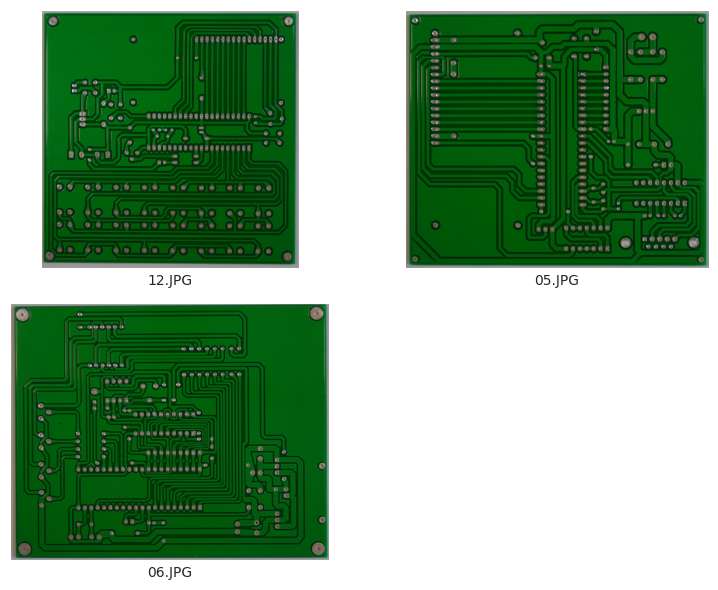

In [ ]:
visualize_img(template_dir,nos_=3)

print(f'No of template images:{len(os.listdir(template_dir))}')

**Analyzing the images folder**

In [ ]:
#Defining the image directory
img_dir='/content/pcb-defects/PCB_DATASET/images'

#Listing the types of defects
os.listdir(img_dir)
types_defect=os.listdir(os.path.join(input_dir,'images'))
types_defect

['Spur',
 'Missing_hole',
 'Open_circuit',
 'Spurious_copper',
 'Mouse_bite',
 'Short']

No of template images:10


In [ ]:
print(img_dir)


/content/pcb-defects/PCB_DATASET/images


In [ ]:
#Creating an image path list for ready refernce
img_path_list=[]
#Creating img_path list
for sub_cat in types_defect:
    for file in os.listdir(os.path.join(img_dir,sub_cat)):

        img_path_list.append(os.path.join(img_dir,sub_cat,file))


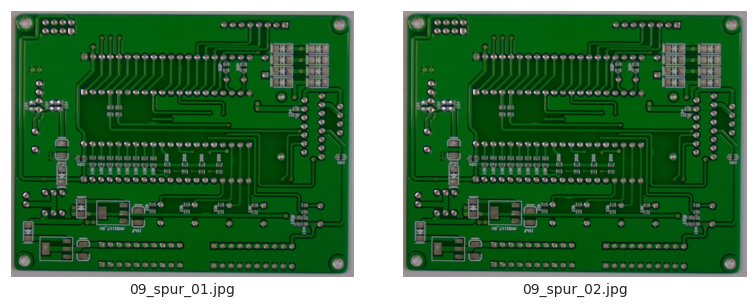

No of Spur images:115


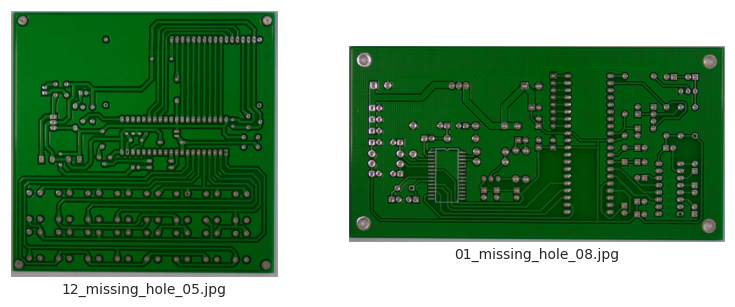

No of Missing_hole images:115


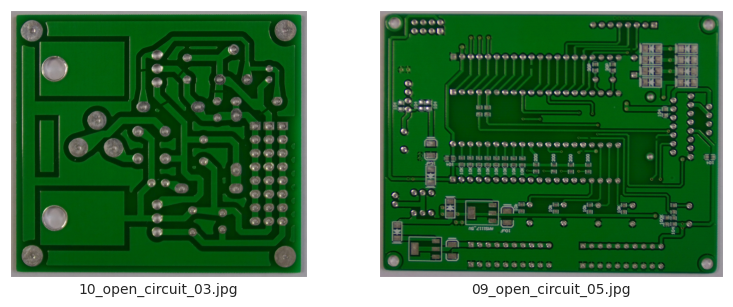

No of Open_circuit images:116


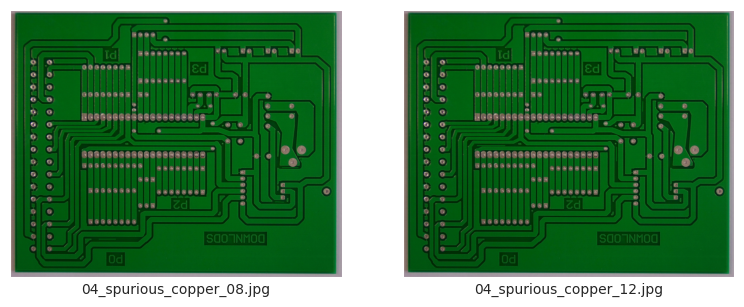

No of Spurious_copper images:116


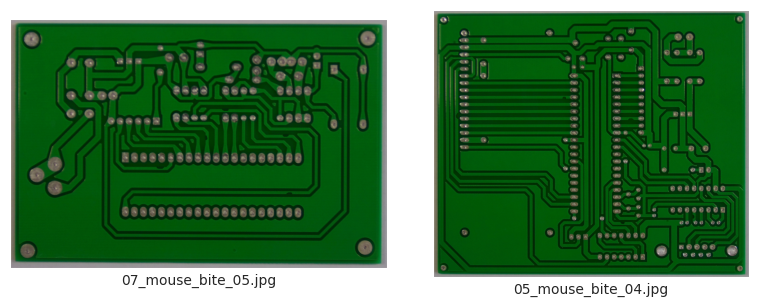

No of Mouse_bite images:115


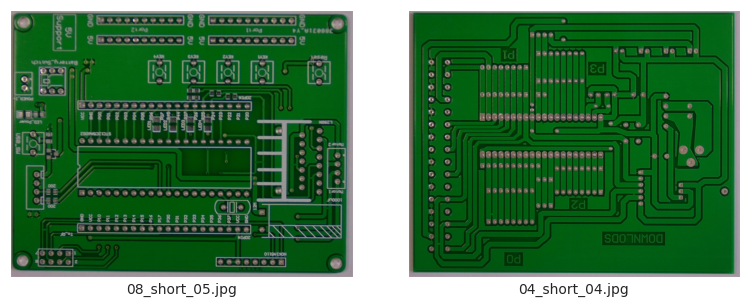

No of Short images:116


In [ ]:
#Vizualizing defect images for each type
df_defect=pd.DataFrame(columns=['No of defect']) #dataframe for counting no of defects
for sub_cat in types_defect:
    visualize_img(os.path.join(img_dir,sub_cat),nos_=2)  #Visualizing 2 types of defect for each type

    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(img_dir,sub_cat)))}')

    df_defect.loc[sub_cat]=len(os.listdir(os.path.join(img_dir,sub_cat)))


In [ ]:
#No. of defects by type
df_defect

,No of defect
Spur,115
Missing_hole,115
Open_circuit,116
Spurious_copper,116
Mouse_bite,115
Short,116


**Analyzing rotated folder**

In [ ]:
rotated_dir=os.path.join(input_dir,'rotation')
os.listdir(rotated_dir)

['Short_rotation',
 'Missing_hole_angles.txt',
 'Short_angles.txt',
 'Spurious_copper_rotation',
 'Mouse_bite_angles.txt',
 'Mouse_bite_rotation',
 'Spur_rotation',
 'Spurious_copper_angles.txt',
 'Spur_angles.txt',
 'Open_circuit_rotation',
 'Missing_hole_rotation',
 'Open_circuit_angles.txt']

In [ ]:
rotated_angle_list=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')]
rotated_angle_list

['Missing_hole_angles.txt',
 'Short_angles.txt',
 'Mouse_bite_angles.txt',
 'Spurious_copper_angles.txt',
 'Spur_angles.txt',
 'Open_circuit_angles.txt']

In [ ]:
types_defect_rotated=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')==False]
types_defect_rotated

['Short_rotation',
 'Spurious_copper_rotation',
 'Mouse_bite_rotation',
 'Spur_rotation',
 'Open_circuit_rotation',
 'Missing_hole_rotation']

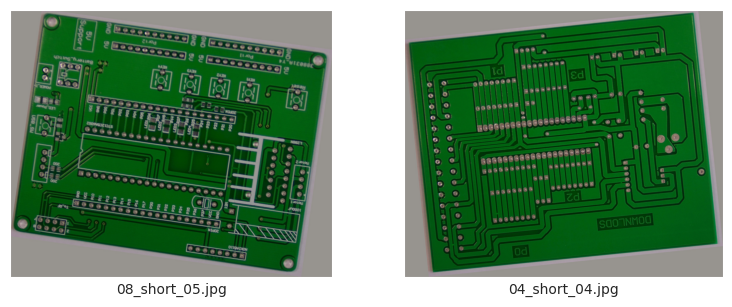

No of Short_rotation images:116


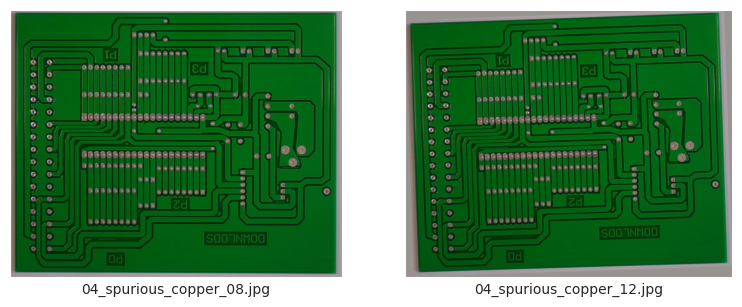

No of Spurious_copper_rotation images:116


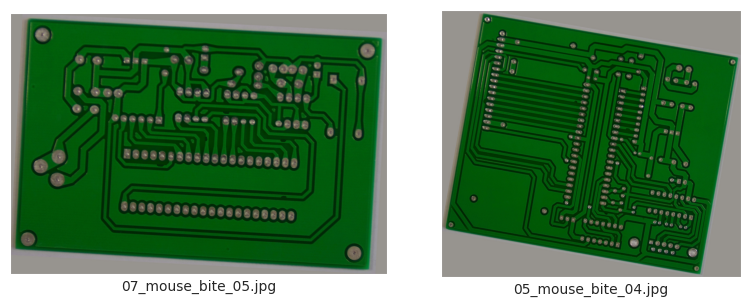

No of Mouse_bite_rotation images:115


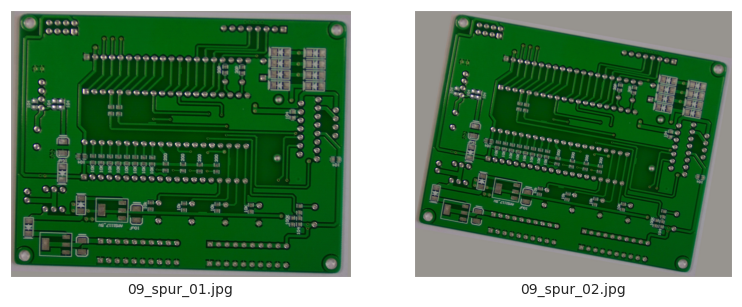

No of Spur_rotation images:115


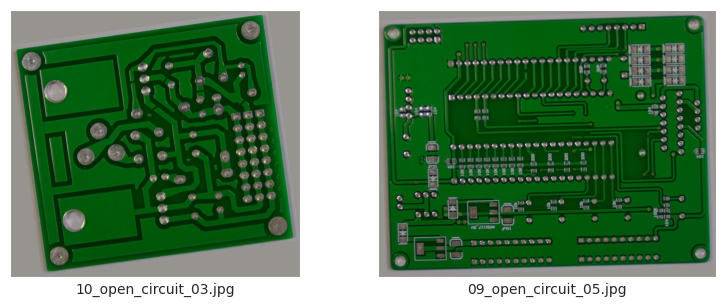

No of Open_circuit_rotation images:116


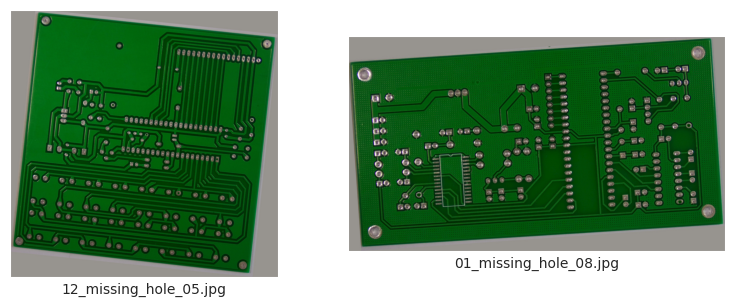

No of Missing_hole_rotation images:115


In [ ]:
#Vizualizing rotated defects
df_defect_rotated=pd.DataFrame(columns=['No of defect'])
for sub_cat in types_defect_rotated:
    visualize_img(os.path.join(rotated_dir,sub_cat),nos_=2)

    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(rotated_dir,sub_cat)))}')

    df_defect_rotated.loc[sub_cat]=len(os.listdir(os.path.join(rotated_dir,sub_cat)))

In [ ]:
#No. of defects by type  rotated
df_defect_rotated

,No of defect
Short_rotation,116
Spurious_copper_rotation,116
Mouse_bite_rotation,115
Spur_rotation,115
Open_circuit_rotation,116
Missing_hole_rotation,115


**Analyzing the annotate folder**

In [ ]:
annote_dir=os.path.join(input_dir,'Annotations')
annote_dir

'/content/pcb-defects/PCB_DATASET/Annotations'

In [ ]:
type_annot=os.listdir(annote_dir)
type_annot

['Spur',
 'Missing_hole',
 'Open_circuit',
 'Spurious_copper',
 'Mouse_bite',
 'Short']

In [ ]:
df_annot_nos=pd.DataFrame(columns=['No of annotations'])
#Checking the length of annotation itms
for i in type_annot:
    df_annot_nos.loc[i]=len(os.listdir(os.path.join(annote_dir,i)))
df_annot_nos

,No of annotations
Spur,115
Missing_hole,115
Open_circuit,116
Spurious_copper,116
Mouse_bite,115
Short,116


We see that we have an annotation file for each image

In [ ]:
#Checking the type of files
file_list=os.listdir(os.path.join(annote_dir,'Mouse_bite'))
file_list[0:5]

['04_mouse_bite_05.xml',
 '01_mouse_bite_01.xml',
 '01_mouse_bite_02.xml',
 '01_mouse_bite_04.xml',
 '04_mouse_bite_16.xml']

We see that all files are in XML format, so we have to parse the data

In [ ]:
#importing xml ET to parse xml file
import xml.etree.ElementTree as ET



In [ ]:
tree = ET.parse(os.path.join(os.path.join(annote_dir,'Mouse_bite'),'01_mouse_bite_11.xml'))
root = tree.getroot()

In [ ]:
#getting the structure of XML file
print(ET.tostring(root, encoding='utf8').decode('utf8'))

<?xml version='1.0' encoding='utf8'?>
<annotation>
	<folder>Mouse_bite</folder>
	<filename>01_mouse_bite_11.jpg</filename>
	<path>/home/weapon/Desktop/PCB_DATASET/Mouse_bite/01_mouse_bite_11.jpg</path>
	<source>
		<database>Unknown</database>
	</source>
	<size>
		<width>3034</width>
		<height>1586</height>
		<depth>3</depth>
	</size>
	<segmented>0</segmented>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>1199</xmin>
			<ymin>966</ymin>
			<xmax>1234</xmax>
			<ymax>1004</ymax>
		</bndbox>
	</object>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>2042</xmin>
			<ymin>755</ymin>
			<xmax>2073</xmax>
			<ymax>786</ymax>
		</bndbox>
	</object>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>1472</xmin>
			<ymin>607</ymin>
		

In [ ]:
#Parsing XML to return Bounding box dimensions
def parse_xml(xml_file):

    data=[]

    tree = ET.parse(xml_file)
    root = tree.getroot()

    filename = root.find('filename').text
    width = int(root.find('size/width').text)
    height = int(root.find('size/height').text)
    for obj in root.findall('object'):
        name = obj.find('name').text
        xmin = int(obj.find('bndbox/xmin').text)
        ymin = int(obj.find('bndbox/ymin').text)
        xmax = int(obj.find('bndbox/xmax').text)
        ymax = int(obj.find('bndbox/ymax').text)

        data.append({
            'filename': filename,
            'width': width,
            'height': height,
            'class': name,
            'xmin': xmin,
            'ymin': ymin,
            'xmax': xmax,
            'ymax': ymax
        })

    return data

In [ ]:
#Retrieving data for all files
data=[]
all_data=[]

for x in type_annot:
    for file in os.listdir(os.path.join(annote_dir,x)):
        xml_file_path=os.path.join(os.path.join(annote_dir,x),file)
        data=parse_xml(xml_file_path)
        all_data.extend(data)


In [ ]:
#Creating a dataframe to store the annotations
df_annot=pd.DataFrame(all_data)
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax
0,10_spur_01.jpg,2240,2016,spur,1134,722,1236,812
1,10_spur_01.jpg,2240,2016,spur,1419,311,1521,374
2,10_spur_01.jpg,2240,2016,spur,1984,473,2049,571
3,10_spur_01.jpg,2240,2016,spur,1050,1061,1117,1179
4,10_spur_01.jpg,2240,2016,spur,1514,1258,1584,1377
...,...,...,...,...,...,...,...,...
2948,01_short_16.jpg,3034,1586,short,2144,693,2200,775
2949,01_short_16.jpg,3034,1586,short,617,884,659,933
2950,05_short_03.jpg,2544,2156,short,2285,1818,2364,1893
2951,05_short_03.jpg,2544,2156,short,2400,1684,2460,1740


Text(0.5, 0, 'No of defects in one PCB')

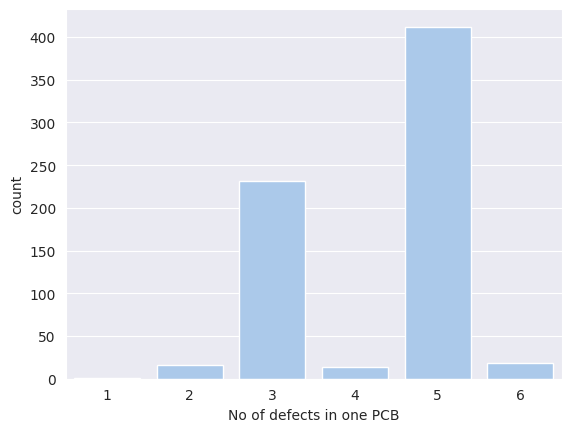

In [ ]:
#Visualizing the no of defects in each pcb
df_multiple_defects=pd.DataFrame(df_annot['filename'].value_counts())
sns.countplot(df_multiple_defects,x='count')
plt.xlabel('No of defects in one PCB')

There are 1-6 no. of defects in same PCB, with most cases being 3 or 5

In [ ]:
#Defin|g a function to view image along with bounding box

def draw_bounding_boxes(image_path, bounding_boxes,annotation):


    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(15,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box
    for bbox in bounding_boxes:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation,(centroid_x,centroid_y),(max_x+20,max_y+20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')

    plt.grid(False)
    plt.xticks([])
    plt.yticks([])



    # Show the plot
    plt.show()

In [ ]:
#Getting filename from filepath
filepath=img_path_list[0]
filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
filename

'09_spur_01.jpg'

In [ ]:
#Defining function to select the a file and return image along with bounding box
def visualize_annotations(list_image_path,df):
    for i in list_image_path:
        filepath=i
        filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
        df_selected=df[df['filename']==filename]
        width=df_selected['width'].values
        height=df_selected['height'].values
        class_name=df_selected['class'].values
        xmin=df_selected['xmin'].values
        ymin=df_selected['ymin'].values
        xmax=df_selected['xmax'].values
        ymax=df_selected['ymax'].values

        bbox=zip(xmin,ymin,xmax,ymax)
        draw_bounding_boxes(filepath, bbox,class_name[0])

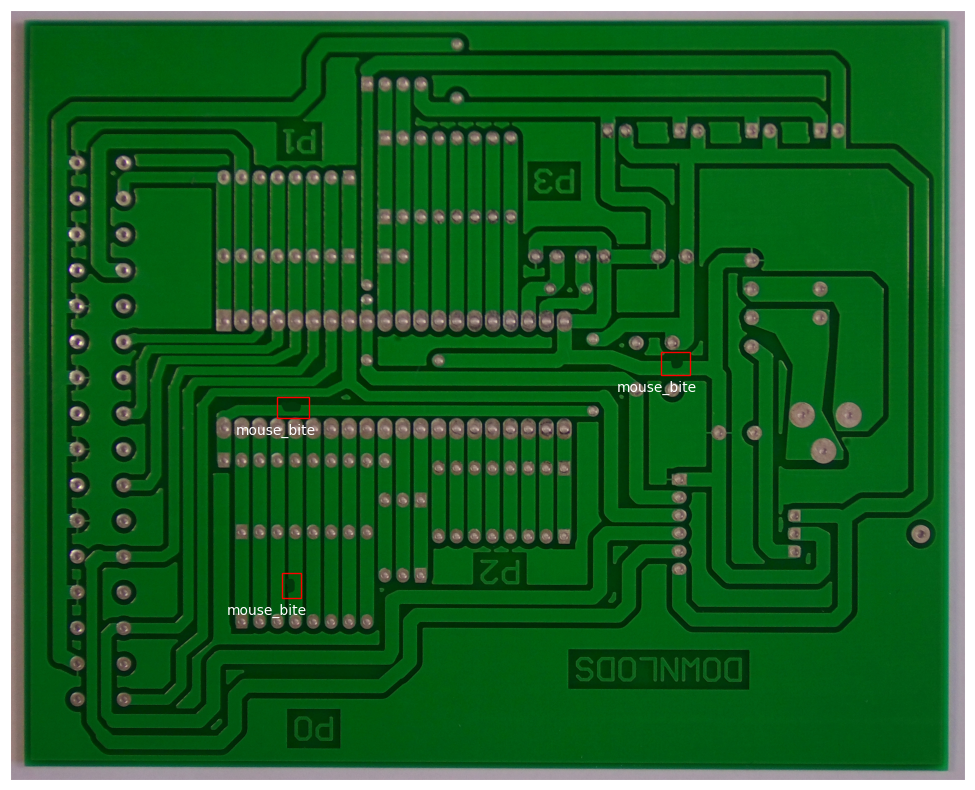

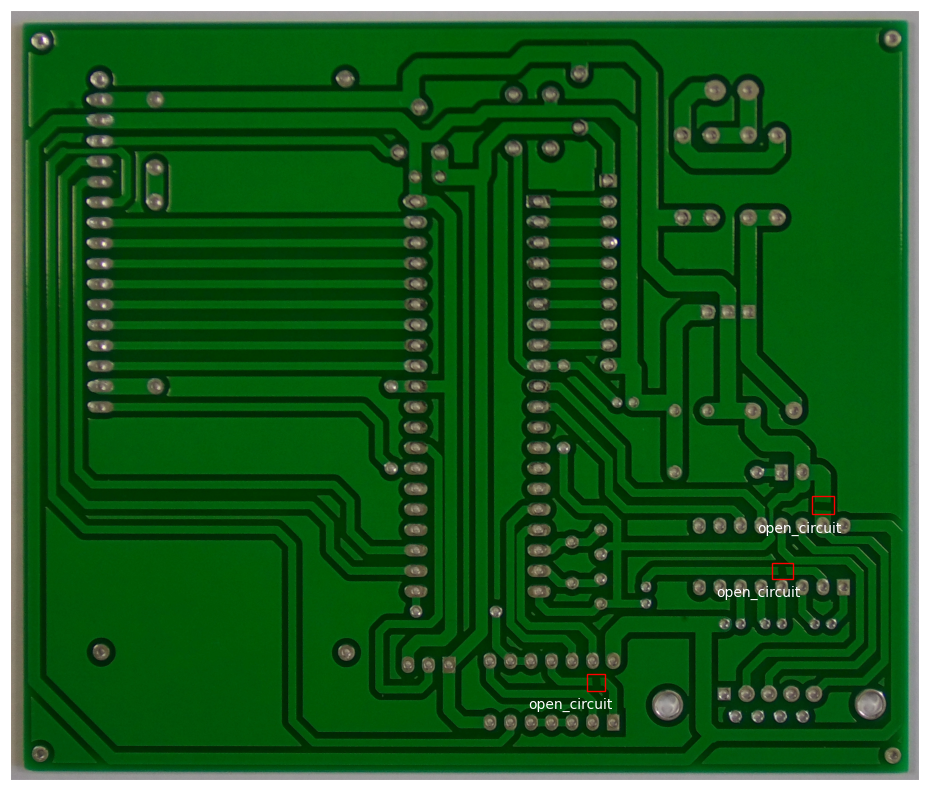

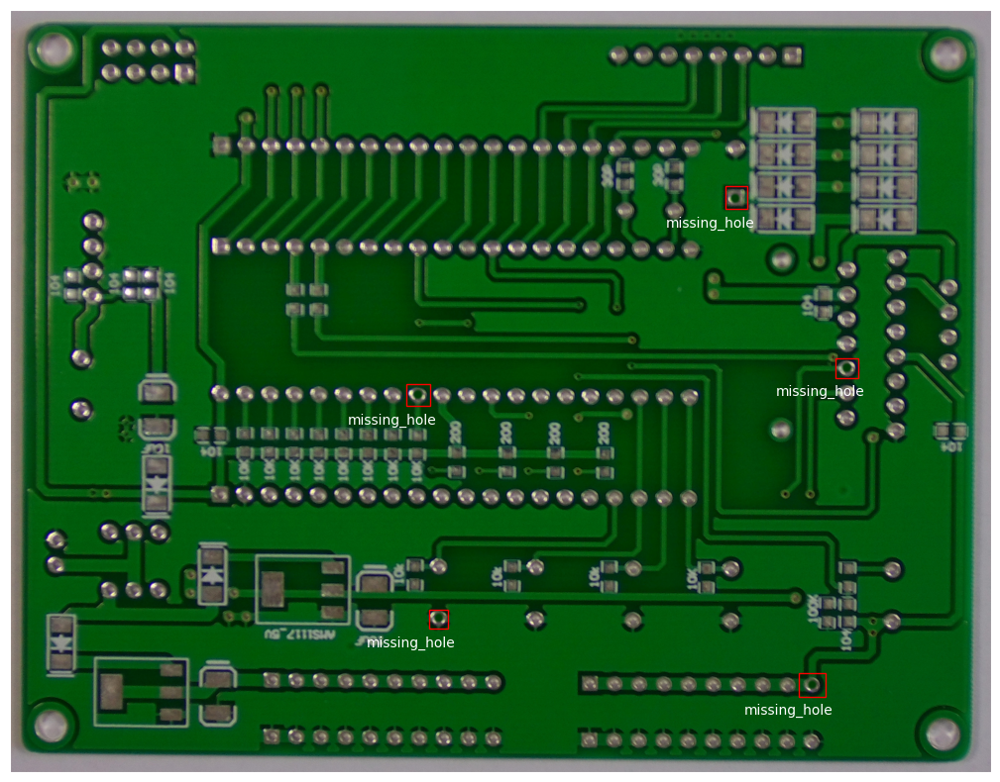

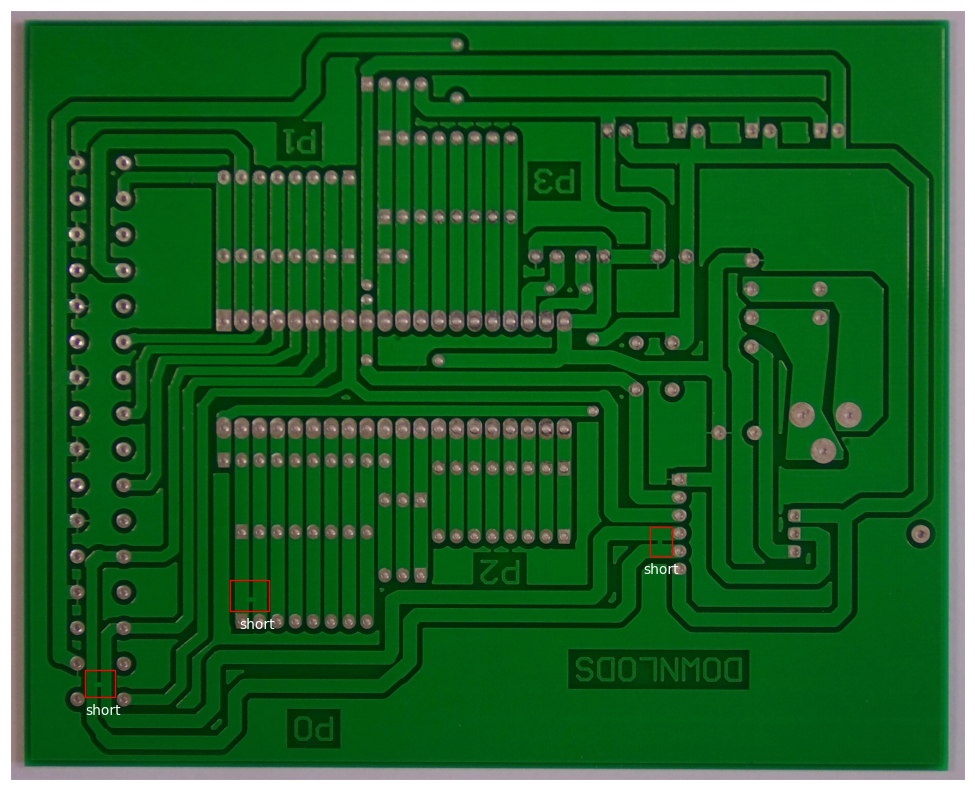

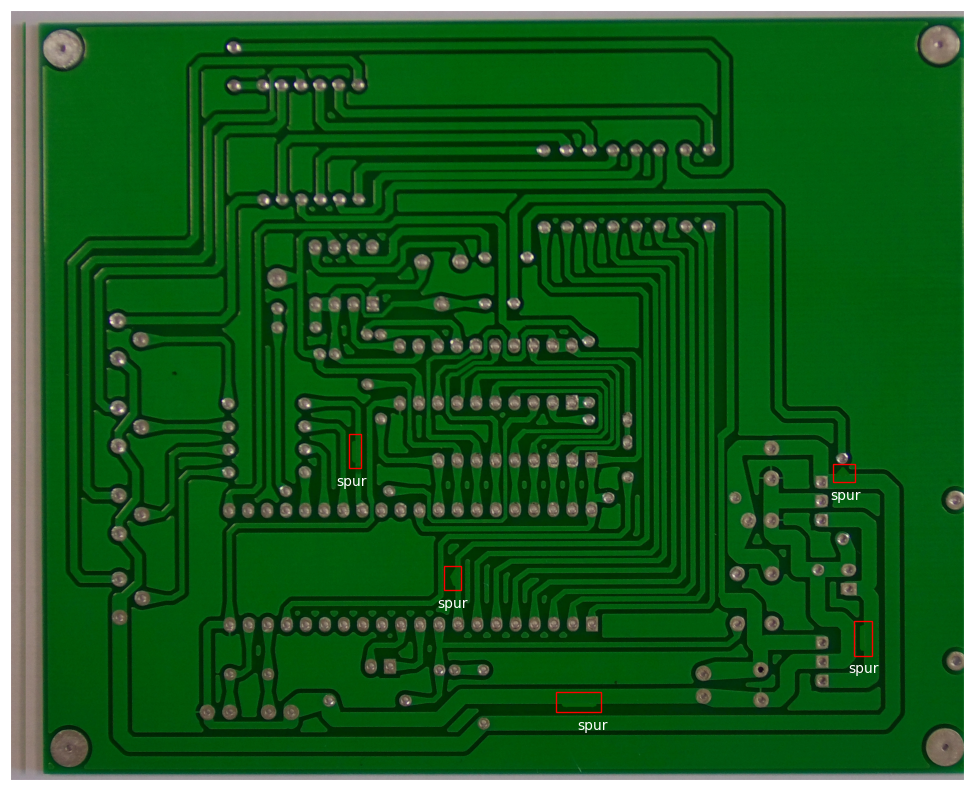

In [ ]:
image_path_shuffle=img_path_list
random.shuffle(image_path_shuffle)

visualize_annotations(image_path_shuffle[0:5],df_annot)

# **Preparing data for inputting to YOLO**

In [ ]:
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax
0,10_spur_01.jpg,2240,2016,spur,1134,722,1236,812
1,10_spur_01.jpg,2240,2016,spur,1419,311,1521,374
2,10_spur_01.jpg,2240,2016,spur,1984,473,2049,571
3,10_spur_01.jpg,2240,2016,spur,1050,1061,1117,1179
4,10_spur_01.jpg,2240,2016,spur,1514,1258,1584,1377
...,...,...,...,...,...,...,...,...
2948,01_short_16.jpg,3034,1586,short,2144,693,2200,775
2949,01_short_16.jpg,3034,1586,short,617,884,659,933
2950,05_short_03.jpg,2544,2156,short,2285,1818,2364,1893
2951,05_short_03.jpg,2544,2156,short,2400,1684,2460,1740


We need to create a directory structure with images and annotation as subfolder

In [ ]:
root_dir=os.getcwd()

In [ ]:
#Creating the dataset directory along with images and labels sub-directory
os.makedirs(os.path.join(root_dir,'dataset'),exist_ok=True)
dataset_dir=os.path.join(root_dir,'dataset')

images_dir = os.path.join(dataset_dir, 'images')  #images directory
labels_dir = os.path.join(dataset_dir, 'labels')  #annotations directory
os.makedirs(images_dir,exist_ok=True)
os.makedirs(labels_dir,exist_ok=True)

In [ ]:
os.listdir(dataset_dir)

['images', 'labels']

In [ ]:
#Checking the no of files
len(img_path_list)

693

In [ ]:
#Now splitting our images path list for train,val and test
random.seed(42)
random.shuffle(img_path_list)

train_test_split=0.95
train_val_split=0.8

total_train_len=int(len(img_path_list)*train_test_split)
train_len=int(total_train_len*train_val_split)
val_len=total_train_len-train_len
test_len=len(img_path_list)-train_len-val_len

print(f'Train length:{train_len},Validation length:{val_len},Test length:{test_len}')

Train length:526,Validation length:132,Test length:35


In [ ]:
def path_to_name(filepath):
    filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
    return filename

In [ ]:
#Defining a function to copy images from original to target directory
def copy_images_to_dir(original_dir,target_dir,train_len,val_len):

    #Removing all sub-directories ,if exists, to remove duplication
    if os.path.exists(os.path.join(target_dir,'train')):
        shutil.rmtree(os.path.join(target_dir,'train'))
        shutil.rmtree(os.path.join(target_dir,'val'))
        shutil.rmtree(os.path.join(target_dir,'test'))


    #Making new dircetories within target_dir
    os.makedirs(os.path.join(target_dir,'train'),exist_ok=True)
    os.makedirs(os.path.join(target_dir,'val'),exist_ok=True)
    os.makedirs(os.path.join(target_dir,'test'),exist_ok=True)

    #Copying files
    for filepath in img_path_list[:train_len]:
        filename=path_to_name(filepath)
        shutil.copy(filepath, os.path.join(images_dir,'train',filename))

    for filepath in img_path_list[train_len:train_len+val_len]:
        filename=path_to_name(filepath)
        shutil.copy(filepath, os.path.join(images_dir,'val',filename))

    for filepath in img_path_list[train_len+val_len:]:
        filename=path_to_name(filepath)
        shutil.copy(filepath, os.path.join(images_dir,'test',filename))

In [ ]:
copy_images_to_dir(original_dir=input_dir,target_dir=images_dir,train_len=train_len,val_len=val_len)
#Checking the length of files in images dir
print(f"Length of train set:{len(os.listdir(os.path.join(images_dir,'train')))}")
print(f"Length of val set:{len(os.listdir(os.path.join(images_dir,'val')))}")
print(f"Length of test set:{len(os.listdir(os.path.join(images_dir,'test')))}")

Length of train set:526
Length of val set:132
Length of test set:35


In [ ]:

for set in ['train','val','test']:
    for filename in os.listdir(os.path.join(images_dir,set)):
        for i in df_annot[df_annot['filename']==filename].index:
              df_annot.loc[i,'set']=set
df_annot['set'].value_counts()

,count
set,
train,2254
val,549
test,150


In [ ]:
#Defining box dimensions in xywh format [in Normalized format]

df_annot['box_width']=(df_annot['xmax']-df_annot['xmin'])
df_annot['box_height']=(df_annot['ymax']-df_annot['ymin'])

df_annot['x_center']=(df_annot['xmin']+df_annot['box_width']/2)/df_annot['width']
df_annot['y_center']=(df_annot['ymin']+df_annot['box_height']/2)/df_annot['height']

#Normalizing
df_annot['box_width']=df_annot['box_width']/df_annot['width']
df_annot['box_height']=df_annot['box_height']/df_annot['height']
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax,set,box_width,box_height,x_center,y_center
0,10_spur_01.jpg,2240,2016,spur,1134,722,1236,812,train,0.045536,0.044643,0.529018,0.380456
1,10_spur_01.jpg,2240,2016,spur,1419,311,1521,374,train,0.045536,0.031250,0.656250,0.169891
2,10_spur_01.jpg,2240,2016,spur,1984,473,2049,571,train,0.029018,0.048611,0.900223,0.258929
3,10_spur_01.jpg,2240,2016,spur,1050,1061,1117,1179,train,0.029911,0.058532,0.483705,0.555556
4,10_spur_01.jpg,2240,2016,spur,1514,1258,1584,1377,train,0.031250,0.059028,0.691518,0.653522
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2948,01_short_16.jpg,3034,1586,short,2144,693,2200,775,train,0.018457,0.051702,0.715887,0.462799
2949,01_short_16.jpg,3034,1586,short,617,884,659,933,train,0.013843,0.030895,0.210283,0.572825
2950,05_short_03.jpg,2544,2156,short,2285,1818,2364,1893,val,0.031053,0.034787,0.913719,0.860622
2951,05_short_03.jpg,2544,2156,short,2400,1684,2460,1740,val,0.023585,0.025974,0.955189,0.794063


In [ ]:
class_dict=dict(enumerate(df_annot['class'].unique()))
#Preparing the text files
class_dict

{0: 'spur',
 1: 'missing_hole',
 2: 'open_circuit',
 3: 'spurious_copper',
 4: 'mouse_bite',
 5: 'short'}

In [ ]:
reverse_dict={v: k for k, v in class_dict.items()}
df_annot['class_label']=df_annot['class'].map(reverse_dict)
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax,set,box_width,box_height,x_center,y_center,class_label
0,10_spur_01.jpg,2240,2016,spur,1134,722,1236,812,train,0.045536,0.044643,0.529018,0.380456,0
1,10_spur_01.jpg,2240,2016,spur,1419,311,1521,374,train,0.045536,0.031250,0.656250,0.169891,0
2,10_spur_01.jpg,2240,2016,spur,1984,473,2049,571,train,0.029018,0.048611,0.900223,0.258929,0
3,10_spur_01.jpg,2240,2016,spur,1050,1061,1117,1179,train,0.029911,0.058532,0.483705,0.555556,0
4,10_spur_01.jpg,2240,2016,spur,1514,1258,1584,1377,train,0.031250,0.059028,0.691518,0.653522,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2948,01_short_16.jpg,3034,1586,short,2144,693,2200,775,train,0.018457,0.051702,0.715887,0.462799,5
2949,01_short_16.jpg,3034,1586,short,617,884,659,933,train,0.013843,0.030895,0.210283,0.572825,5
2950,05_short_03.jpg,2544,2156,short,2285,1818,2364,1893,val,0.031053,0.034787,0.913719,0.860622,5
2951,05_short_03.jpg,2544,2156,short,2400,1684,2460,1740,val,0.023585,0.025974,0.955189,0.794063,5


In [ ]:
#Defining a funation to create labels dir from dataframe

def create_labels_from_df(label_dir,images_dir,df):

     #Removing all sub-directories ,if exists, to remove duplication
    if os.path.exists(os.path.join(label_dir,'train')):
        shutil.rmtree(os.path.join(label_dir,'train'))
        shutil.rmtree(os.path.join(label_dir,'val'))
        shutil.rmtree(os.path.join(label_dir,'test'))


    #Making new dircetories within label_dir
    os.makedirs(os.path.join(label_dir,'train'),exist_ok=True)
    os.makedirs(os.path.join(label_dir,'val'),exist_ok=True)
    os.makedirs(os.path.join(label_dir,'test'),exist_ok=True)


    #Creating label .txt file in YOLO format
    for i in ['train','test','val']:
        for file_path in os.listdir(os.path.join(images_dir,i)):
            df_temp=df[df['filename']==file_path]
            txt_file_name=".".join([file_path.split('.')[0],'txt'])
            if os.path.exists(os.path.join(label_dir,i,txt_file_name)):
                continue
            else:
                for index, row in df_temp.iterrows():
                    with open(os.path.join(label_dir,i,txt_file_name),'a') as file:
                        file.write(f"{row['class_label']} {row['x_center']} {row['y_center']} {row['box_width']} {row['box_height']}\n" )




In [ ]:
create_labels_from_df(labels_dir,images_dir,df=df_annot)
#Checking the length of files in annotation dir
print(f"Length of train set:{len(os.listdir(os.path.join(labels_dir,'train')))}")
print(f"Length of val set:{len(os.listdir(os.path.join(labels_dir,'val')))}")
print(f"Length of test set:{len(os.listdir(os.path.join(labels_dir,'test')))}")

Length of train set:526
Length of val set:132
Length of test set:35


# **Preparing Model**

We will use the YOLO model from ultralytics to perform our object detection

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 899.0/899.0 kB 21.9 MB/s eta 0:00:00


In [ ]:
#Creating YAML format
data_yaml={
    'path':str(os.path.join(root_dir,'dataset')),
    'train':'images/train',
    'val':'images/val',
    'test':'images/test',
    'nc': len(class_dict),
    'names': list(class_dict.values())
}
data_yaml

{'path': '/content/dataset',
 'train': 'images/train',
 'val': 'images/val',
 'test': 'images/test',
 'nc': 6,
 'names': ['spur',
  'missing_hole',
  'open_circuit',
  'spurious_copper',
  'mouse_bite',
  'short']}

In [ ]:
#Creating yaml file
import yaml

#Writing to yaml file
with open('data.yaml', 'w') as f:
    yaml.dump(data_yaml, f, default_flow_style=False)

In [ ]:
#Training YOLO model
from ultralytics import YOLO
import ultralytics as ultralytics

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
#Loading model
model=YOLO('yolo11m.pt')

100%|██████████| 38.8M/38.8M [00:00<00:00, 203MB/s]


In [ ]:
#Disabling weights & biases metrics
os.environ['WANDB_MODE'] = 'disabled'

In [ ]:
#Training the model
results=model.train(data=os.path.join(root_dir,'data.yaml'),epochs=200)

Ultralytics 8.3.50 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11m.pt, data=/content/data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, 

100%|██████████| 755k/755k [00:00<00:00, 18.6MB/s]


Overriding model.yaml nc=80 with nc=6

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  1    111872  ultralytics.nn.modules.block.C3k2            [128, 256, 1, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  1    444928  ultralytics.nn.modules.block.C3k2            [256, 512, 1, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  1   1380352  ultralytics.nn.modules.block.C3k2            [512, 512, 1, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 105MB/s]


AMP: checks passed ✅


train: Scanning /content/dataset/labels/train... 526 images, 0 backgrounds, 0 corrupt: 100%|██████████| 526/526 [00:00<00:00, 1317.51it/s]


train: New cache created: /content/dataset/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/dataset/labels/val... 132 images, 0 backgrounds, 0 corrupt: 100%|██████████| 132/132 [00:00<00:00, 804.93it/s]

val: New cache created: /content/dataset/labels/val.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/200       8.8G      3.146       9.85       1.51         81        640: 100%|██████████| 33/33 [00:37<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.07s/it]

                   all        132        549      0.398      0.312      0.279      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/200      8.71G      2.288      2.363      1.047         73        640: 100%|██████████| 33/33 [00:33<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.05it/s]


                   all        132        549      0.416      0.488      0.371      0.149

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/200      8.71G      2.143      1.762      1.009         99        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.95it/s]

                   all        132        549      0.818      0.518      0.595      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/200      8.76G      2.059      1.569      1.013         88        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.32it/s]

                   all        132        549      0.823       0.69      0.746      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/200      8.71G      2.038      1.432      1.011         94        640: 100%|██████████| 33/33 [00:33<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.69it/s]

                   all        132        549      0.694      0.701      0.709      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/200      8.78G       1.95      1.309     0.9676         84        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.99it/s]


                   all        132        549      0.755      0.636      0.637      0.234

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/200      8.77G       1.96      1.276     0.9825         91        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.22it/s]


                   all        132        549      0.766      0.765      0.783      0.334

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/200      8.76G      1.904      1.187     0.9709         81        640: 100%|██████████| 33/33 [00:33<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.00it/s]


                   all        132        549      0.847      0.805      0.843      0.391

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/200      8.73G      1.885       1.13     0.9659        101        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.44it/s]

                   all        132        549      0.839      0.785      0.824      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/200      8.77G       1.89      1.141     0.9583         81        640: 100%|██████████| 33/33 [00:39<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.72it/s]

                   all        132        549      0.902      0.777      0.838      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/200      8.76G      1.853      1.106     0.9637         96        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.17it/s]

                   all        132        549      0.894      0.794      0.864      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/200      8.76G      1.855      1.124     0.9513         89        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.47it/s]

                   all        132        549      0.903       0.82      0.874       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/200       8.7G      1.784      1.049     0.9359         80        640: 100%|██████████| 33/33 [00:33<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.34it/s]

                   all        132        549      0.871      0.764      0.831      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/200      8.75G      1.798      1.039     0.9421        136        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]

                   all        132        549      0.819      0.774      0.834      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/200      8.76G      1.762      1.002     0.9365         71        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        132        549      0.833      0.722      0.761      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/200      8.77G      1.811      1.026     0.9475        100        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.32it/s]

                   all        132        549      0.921      0.829      0.876      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/200      8.67G      1.732     0.9979     0.9325         99        640: 100%|██████████| 33/33 [00:33<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.74it/s]

                   all        132        549      0.895      0.758       0.82      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/200      8.78G      1.686     0.9365     0.9172         84        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]

                   all        132        549      0.919      0.857      0.902       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/200      8.75G      1.675     0.9109     0.9163         90        640: 100%|██████████| 33/33 [00:33<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.39it/s]


                   all        132        549      0.949      0.853      0.899      0.438

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/200      8.76G      1.717     0.9372     0.9181         66        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]


                   all        132        549      0.913      0.833      0.877      0.403

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/200      8.67G        1.7     0.9287     0.9184         94        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.33it/s]

                   all        132        549      0.907      0.796      0.848      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/200      8.73G      1.687     0.9007     0.9235         87        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]


                   all        132        549      0.888      0.848      0.871      0.359

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/200      8.76G       1.73     0.9216     0.9269        103        640: 100%|██████████| 33/33 [00:34<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.86it/s]

                   all        132        549      0.911      0.865      0.898      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/200      8.75G      1.732     0.9281     0.9302         80        640: 100%|██████████| 33/33 [00:31<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.16it/s]

                   all        132        549       0.92      0.825      0.883      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/200       8.7G      1.675     0.9275     0.9157        105        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.76it/s]


                   all        132        549      0.925       0.87       0.91      0.453

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/200      8.75G      1.653     0.8855     0.9104         82        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.34it/s]

                   all        132        549      0.895       0.83      0.876      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/200      8.76G      1.658     0.8825     0.9267         88        640: 100%|██████████| 33/33 [00:36<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.78it/s]


                   all        132        549      0.924      0.862      0.913      0.459

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/200      8.77G      1.648     0.8867     0.9117        103        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.66it/s]

                   all        132        549      0.939      0.828      0.895      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/200      8.67G       1.61     0.8459     0.9096        101        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]

                   all        132        549      0.921      0.834      0.875      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/200      8.76G      1.619     0.8645     0.9038         76        640: 100%|██████████| 33/33 [00:36<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.96it/s]

                   all        132        549      0.927      0.853      0.901      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/200      8.76G      1.615     0.8338     0.9188        119        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.46it/s]

                   all        132        549      0.941       0.87      0.909      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/200      8.77G      1.631     0.8399     0.9043        114        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]

                   all        132        549      0.914      0.876      0.908      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/200      8.73G      1.636     0.8414     0.9146         79        640: 100%|██████████| 33/33 [00:36<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]


                   all        132        549      0.962      0.881      0.926      0.459

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/200      8.73G      1.596     0.8404     0.9037        112        640: 100%|██████████| 33/33 [00:32<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.33it/s]

                   all        132        549      0.947      0.892      0.917      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/200      8.78G      1.583     0.8054     0.9057         78        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.88it/s]

                   all        132        549      0.904      0.902      0.915      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/200      8.79G       1.58     0.8168     0.9089         90        640: 100%|██████████| 33/33 [00:30<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.19it/s]

                   all        132        549      0.975      0.854      0.928       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/200      8.71G       1.57     0.8113     0.9025         92        640: 100%|██████████| 33/33 [00:33<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.84it/s]


                   all        132        549      0.943      0.879      0.916      0.483

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/200      8.76G      1.601     0.8103     0.8971         76        640: 100%|██████████| 33/33 [00:32<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.51it/s]

                   all        132        549      0.911      0.905      0.923      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/200      8.75G      1.608     0.8223     0.9069         99        640: 100%|██████████| 33/33 [00:36<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.99it/s]

                   all        132        549      0.939      0.889      0.923      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/200      8.73G      1.601     0.8337     0.9005         95        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.34it/s]

                   all        132        549      0.922      0.856      0.898      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/200      8.71G      1.566     0.7897     0.8948         95        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]


                   all        132        549      0.957      0.876      0.928      0.471

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/200      8.79G      1.613     0.8116     0.9108        118        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]


                   all        132        549      0.933      0.901      0.932      0.481

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/200      8.75G      1.537     0.7719     0.8935         55        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.20it/s]

                   all        132        549      0.939       0.88      0.917      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/200      8.75G      1.558     0.7835     0.9012         75        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.96it/s]

                   all        132        549      0.935      0.877      0.912      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/200      8.73G      1.588     0.8193      0.898         89        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        132        549       0.94        0.9      0.936      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/200      8.77G      1.538     0.7992     0.8961         79        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.78it/s]

                   all        132        549      0.965      0.865       0.92      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/200      8.71G      1.566     0.7949     0.8924        115        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.78it/s]

                   all        132        549      0.937      0.883      0.921      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/200      8.71G      1.554     0.7827     0.8963         84        640: 100%|██████████| 33/33 [00:32<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.78it/s]

                   all        132        549       0.96      0.875      0.923      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/200      8.71G      1.562     0.7664     0.9012         78        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]

                   all        132        549      0.945      0.871      0.922      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/200      8.76G      1.525     0.7725     0.8919         88        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.26it/s]

                   all        132        549      0.938       0.88      0.926      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/200      8.78G      1.563     0.7892     0.8818         95        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.84it/s]


                   all        132        549      0.964      0.897      0.939       0.49

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/200      8.76G       1.48     0.7289     0.8819         97        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]


                   all        132        549      0.962      0.868      0.928      0.506

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/200       8.7G      1.534     0.7732       0.88         59        640: 100%|██████████| 33/33 [00:33<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.66it/s]

                   all        132        549      0.958      0.896      0.935      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/200      8.78G      1.504     0.7571     0.8817         88        640: 100%|██████████| 33/33 [00:36<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]

                   all        132        549      0.949      0.896      0.931      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/200      8.78G      1.542     0.7499     0.8824        123        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.40it/s]

                   all        132        549      0.936      0.877      0.916      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/200      8.77G      1.489     0.7385     0.8847         90        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.72it/s]


                   all        132        549      0.912      0.907      0.929      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/200      8.73G      1.492     0.7344     0.8777         90        640: 100%|██████████| 33/33 [00:36<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.92it/s]

                   all        132        549      0.953      0.902      0.937      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/200      8.77G       1.49     0.7394     0.8813        101        640: 100%|██████████| 33/33 [00:32<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.34it/s]

                   all        132        549      0.947      0.911      0.944      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/200      8.78G      1.492     0.7342     0.8798         94        640: 100%|██████████| 33/33 [00:36<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.99it/s]

                   all        132        549      0.951      0.885      0.935      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/200      8.75G      1.475     0.7271     0.8855         75        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.74it/s]

                   all        132        549      0.941      0.922      0.938      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/200      8.73G      1.494     0.7145     0.8778        113        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.16it/s]

                   all        132        549      0.955       0.89      0.931      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/200      8.77G      1.488     0.7275     0.8806        107        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.72it/s]


                   all        132        549      0.952      0.905      0.938      0.491

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/200      8.77G      1.479     0.7177     0.8852         77        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.54it/s]

                   all        132        549      0.954      0.906      0.932      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/200      8.74G      1.434     0.7107     0.8729        105        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.02it/s]

                   all        132        549      0.941      0.894      0.935      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/200      8.72G      1.471     0.7407     0.8826         75        640: 100%|██████████| 33/33 [00:36<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]


                   all        132        549      0.942      0.911       0.94      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/200      8.75G      1.475     0.7282     0.8684         93        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.36it/s]

                   all        132        549      0.963       0.91      0.945      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/200      8.75G      1.465      0.714     0.8731         64        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.71it/s]


                   all        132        549      0.955      0.891      0.937      0.488

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/200      8.78G      1.447     0.7055      0.871         76        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.63it/s]

                   all        132        549      0.961      0.894      0.937      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/200      8.73G      1.444     0.7003     0.8761         87        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.50it/s]


                   all        132        549      0.955      0.914      0.941      0.499

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/200      8.75G      1.464      0.717     0.8751         86        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.05it/s]

                   all        132        549      0.944      0.904      0.935      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/200      8.77G      1.418     0.6955     0.8689         94        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.24it/s]

                   all        132        549      0.942      0.932      0.942      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/200      8.76G      1.444     0.6984     0.8679         73        640: 100%|██████████| 33/33 [00:36<00:00,  1.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.77it/s]

                   all        132        549      0.949      0.914      0.945      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/200      8.69G      1.464     0.6941     0.8742        108        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.44it/s]

                   all        132        549      0.936      0.905       0.93      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/200      8.72G      1.402     0.6771     0.8767        120        640: 100%|██████████| 33/33 [00:36<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.00it/s]

                   all        132        549      0.967      0.867      0.935      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/200      8.77G      1.412     0.6859     0.8665         83        640: 100%|██████████| 33/33 [00:31<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.16it/s]

                   all        132        549      0.947      0.874       0.93      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/200      8.75G       1.42     0.6973     0.8703        121        640: 100%|██████████| 33/33 [00:36<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.75it/s]

                   all        132        549      0.951      0.914      0.935      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/200      8.71G      1.409     0.6914     0.8765         68        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.65it/s]

                   all        132        549      0.934      0.924      0.938      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/200      8.78G      1.397     0.6747     0.8677        128        640: 100%|██████████| 33/33 [00:33<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.84it/s]

                   all        132        549      0.959      0.905      0.947      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/200      8.74G      1.389      0.673     0.8686        111        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.79it/s]

                   all        132        549      0.953      0.922      0.947      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/200      8.76G      1.394     0.6847     0.8614        118        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.63it/s]

                   all        132        549      0.938      0.917      0.941      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/200      8.71G      1.417     0.6779     0.8669         80        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.99it/s]

                   all        132        549      0.952      0.892      0.928      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/200      8.78G      1.383      0.678     0.8774         77        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.61it/s]

                   all        132        549      0.956      0.881      0.929      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/200      8.76G      1.376     0.6601      0.864         86        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.50it/s]

                   all        132        549      0.949      0.906       0.94       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/200      8.78G      1.367     0.6476     0.8658         76        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        132        549      0.953      0.921      0.943      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/200      8.73G      1.405     0.6986     0.8621         90        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.49it/s]

                   all        132        549      0.958      0.898      0.938      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/200      8.75G      1.377     0.6597     0.8763         75        640: 100%|██████████| 33/33 [00:38<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.99it/s]

                   all        132        549      0.955      0.912      0.943      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/200      8.76G      1.348     0.6579     0.8658        113        640: 100%|██████████| 33/33 [00:31<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.17it/s]

                   all        132        549      0.952       0.91      0.941      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/200      8.74G      1.362     0.6494     0.8641         84        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.80it/s]

                   all        132        549      0.947      0.925      0.954      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/200      8.71G      1.368     0.6513     0.8589         93        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.65it/s]

                   all        132        549      0.953      0.907      0.946      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/200      8.77G      1.374     0.6637     0.8583         78        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.76it/s]


                   all        132        549      0.922      0.917      0.943      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/200      8.76G      1.364     0.6377     0.8629        105        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.95it/s]

                   all        132        549      0.933      0.912      0.934      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/200      8.78G      1.359     0.6541     0.8572         89        640: 100%|██████████| 33/33 [00:37<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.34it/s]

                   all        132        549      0.953       0.87      0.921      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/200      8.73G      1.354     0.6509     0.8558         84        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.86it/s]

                   all        132        549      0.948      0.922      0.945      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/200      8.76G      1.344     0.6486     0.8589         80        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]


                   all        132        549      0.956      0.928      0.949      0.517

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/200      8.76G      1.348     0.6432     0.8608        115        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.53it/s]

                   all        132        549      0.958      0.927      0.953       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/200      8.74G      1.335     0.6305     0.8605        119        640: 100%|██████████| 33/33 [00:33<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.75it/s]

                   all        132        549      0.923      0.902      0.944      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/200      8.73G      1.332     0.6473     0.8519         92        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.31it/s]

                   all        132        549      0.956      0.921      0.948      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/200      8.75G      1.324      0.634     0.8528        100        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]

                   all        132        549      0.958      0.926       0.94      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/200      8.74G      1.305     0.6268      0.854        100        640: 100%|██████████| 33/33 [00:37<00:00,  1.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.52it/s]

                   all        132        549      0.964      0.911      0.943      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/200      8.75G      1.314     0.6423     0.8558         77        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]

                   all        132        549      0.963      0.909      0.944      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/200      8.71G      1.316     0.6277       0.86         90        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.84it/s]


                   all        132        549      0.954      0.903      0.942      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/200      8.79G      1.321      0.621     0.8538         99        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.41it/s]

                   all        132        549      0.966      0.903      0.952      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/200      8.75G       1.28     0.6132     0.8545         82        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.90it/s]


                   all        132        549      0.959      0.906      0.941      0.499

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/200      8.76G      1.306     0.6092     0.8555         89        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.26it/s]

                   all        132        549      0.964      0.902      0.947      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/200      8.73G      1.293     0.6179     0.8521         85        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.87it/s]

                   all        132        549      0.958       0.92      0.949      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/200      8.78G      1.288     0.6223     0.8527         69        640: 100%|██████████| 33/33 [00:38<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.75it/s]

                   all        132        549      0.948      0.926      0.947       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/200       8.7G      1.278     0.6041     0.8474        102        640: 100%|██████████| 33/33 [00:36<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.77it/s]

                   all        132        549      0.968      0.916      0.947      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/200      8.75G      1.285     0.6097     0.8489        124        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.73it/s]

                   all        132        549      0.939      0.911      0.934      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/200      8.67G      1.278     0.6126     0.8455         98        640: 100%|██████████| 33/33 [00:36<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.42it/s]

                   all        132        549       0.95      0.913      0.939      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/200      8.76G      1.238     0.5957     0.8512         93        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.02it/s]

                   all        132        549      0.958      0.901      0.943      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/200      8.74G      1.251     0.5982     0.8463         85        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.96it/s]

                   all        132        549      0.969      0.892      0.943      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/200      8.74G      1.268     0.6105     0.8537         94        640: 100%|██████████| 33/33 [00:39<00:00,  1.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.86it/s]


                   all        132        549      0.956      0.894      0.942      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/200       8.7G      1.266     0.6091     0.8436         56        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.78it/s]

                   all        132        549      0.943      0.908      0.936      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/200      8.76G      1.257     0.5949     0.8473         99        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.32it/s]

                   all        132        549      0.943      0.925      0.945      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/200      8.75G      1.253     0.5848      0.845        117        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        132        549      0.951      0.915      0.936      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/200      8.76G      1.236     0.5817     0.8395         65        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.45it/s]

                   all        132        549      0.944      0.927      0.947       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/200      8.71G      1.198     0.5754     0.8447         86        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.05it/s]

                   all        132        549      0.947      0.915      0.939      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/200      8.76G      1.235     0.5929     0.8435         77        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        132        549       0.96      0.922      0.941      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/200      8.78G       1.22     0.5722     0.8444         93        640: 100%|██████████| 33/33 [00:37<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.18it/s]

                   all        132        549       0.95      0.911      0.943      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/200      8.76G      1.233     0.5868     0.8377         87        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.90it/s]

                   all        132        549      0.967      0.909      0.945      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/200      8.73G      1.228     0.5691     0.8443         86        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.37it/s]

                   all        132        549      0.958      0.924      0.946      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/200      8.77G      1.206     0.5643     0.8425         79        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.68it/s]


                   all        132        549      0.967      0.907      0.954      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/200      8.78G      1.222      0.565     0.8402         82        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.70it/s]

                   all        132        549       0.95      0.927       0.95      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/200      8.77G      1.213     0.5759     0.8503         88        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.22it/s]

                   all        132        549      0.949      0.914      0.936      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/200       8.7G      1.203     0.5636     0.8384        114        640: 100%|██████████| 33/33 [00:38<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.68it/s]


                   all        132        549      0.969      0.905      0.948      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/200      8.76G      1.196      0.575     0.8447         91        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.23it/s]

                   all        132        549      0.962      0.924      0.952      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/200      8.74G      1.192     0.5568     0.8337         81        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        132        549      0.949       0.93      0.954      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/200      8.75G      1.152     0.5511      0.833        110        640: 100%|██████████| 33/33 [00:34<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.65it/s]

                   all        132        549      0.956      0.927      0.947       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/200       8.7G      1.195     0.5659     0.8468         66        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.57it/s]

                   all        132        549      0.957      0.913      0.953      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/200      8.76G      1.178     0.5616     0.8347         81        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.07it/s]

                   all        132        549      0.964      0.919      0.953      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/200      8.76G       1.19     0.5735     0.8291        109        640: 100%|██████████| 33/33 [00:38<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.26it/s]

                   all        132        549      0.965      0.913      0.953       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/200      8.75G        1.2     0.5685     0.8352        114        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.90it/s]

                   all        132        549      0.959       0.93       0.95      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/200      8.73G       1.18     0.5518     0.8369         74        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.54it/s]

                   all        132        549       0.96      0.918      0.942      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/200      8.76G      1.201     0.5612     0.8387        108        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        132        549      0.953      0.915       0.94       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/200      8.76G      1.169     0.5593     0.8339         96        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.04it/s]

                   all        132        549      0.953      0.922      0.947      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/200      8.75G      1.177     0.5662     0.8333        112        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.24it/s]

                   all        132        549      0.939      0.923      0.941      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/200       8.7G      1.193     0.5685      0.832         85        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.85it/s]

                   all        132        549      0.956      0.917      0.945      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/200      8.76G      1.179     0.5629     0.8307         98        640: 100%|██████████| 33/33 [00:36<00:00,  1.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.87it/s]

                   all        132        549       0.95      0.935      0.953      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/200      8.75G      1.128     0.5457     0.8345         91        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.18it/s]

                   all        132        549      0.949      0.919      0.949       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/200      8.74G      1.149      0.547     0.8343        125        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.92it/s]

                   all        132        549      0.946      0.911      0.943       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/200      8.71G      1.145     0.5464     0.8284         91        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.35it/s]

                   all        132        549      0.947      0.913      0.944      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/200      8.77G      1.166     0.5596     0.8336         92        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.94it/s]

                   all        132        549      0.958      0.915       0.95      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/200      8.75G      1.179     0.5485      0.836         83        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.87it/s]

                   all        132        549      0.955      0.937      0.956       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/200      8.74G      1.162     0.5508     0.8314         74        640: 100%|██████████| 33/33 [00:36<00:00,  1.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.51it/s]

                   all        132        549      0.959      0.928      0.954      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/200      8.71G      1.159      0.545     0.8375         90        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.78it/s]


                   all        132        549      0.954      0.941      0.954      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/200      8.76G      1.111       0.53     0.8278        102        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.23it/s]

                   all        132        549      0.959      0.928      0.949      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/200      8.76G      1.132     0.5339     0.8332        106        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.93it/s]

                   all        132        549      0.957      0.917      0.945      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/200      8.74G      1.135     0.5344     0.8335         92        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.80it/s]

                   all        132        549      0.952      0.931      0.948      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/200       8.7G      1.136     0.5275     0.8353         75        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.32it/s]

                   all        132        549      0.961      0.929      0.956      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/200      8.76G      1.116     0.5361     0.8329        101        640: 100%|██████████| 33/33 [00:37<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]

                   all        132        549      0.959      0.917      0.951      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    151/200      8.75G      1.097     0.5088     0.8322         87        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.33it/s]

                   all        132        549      0.955      0.927      0.947      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    152/200      8.74G      1.116     0.5162     0.8309        107        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.93it/s]

                   all        132        549      0.943      0.939      0.949      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    153/200       8.7G      1.136     0.5343     0.8274         98        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.80it/s]

                   all        132        549      0.944      0.931      0.943      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    154/200      8.75G       1.08     0.5054     0.8291        105        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.50it/s]

                   all        132        549      0.954      0.926      0.946      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    155/200      8.77G      1.128     0.5285      0.834         87        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.79it/s]

                   all        132        549      0.955      0.931      0.951      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    156/200      8.74G      1.088     0.5223     0.8264         89        640: 100%|██████████| 33/33 [00:34<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.24it/s]

                   all        132        549      0.955      0.939      0.949      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    157/200      8.73G      1.107     0.5211     0.8342         85        640: 100%|██████████| 33/33 [00:35<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.92it/s]

                   all        132        549      0.952      0.935      0.945      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    158/200      8.75G      1.081     0.5086     0.8243         99        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]

                   all        132        549      0.953      0.934      0.947      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    159/200      8.72G       1.08     0.5089     0.8323         76        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.65it/s]

                   all        132        549      0.959      0.929      0.951      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    160/200      8.76G      1.071     0.5047     0.8255        112        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.97it/s]

                   all        132        549      0.948      0.935      0.953      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    161/200      8.73G      1.061     0.5089     0.8248         87        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.39it/s]

                   all        132        549      0.957      0.939      0.957      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    162/200      8.77G      1.075     0.5021      0.824         87        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.78it/s]

                   all        132        549      0.954      0.933      0.956      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    163/200      8.75G      1.087     0.5055     0.8202         71        640: 100%|██████████| 33/33 [00:36<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.30it/s]

                   all        132        549      0.936      0.943      0.956      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    164/200      8.74G      1.073     0.4994     0.8239        110        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.03it/s]


                   all        132        549      0.947      0.921      0.947       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    165/200      8.73G      1.068     0.5042     0.8228         89        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.56it/s]

                   all        132        549      0.951       0.92      0.942      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    166/200      8.75G      1.065      0.511     0.8219         83        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.65it/s]

                   all        132        549      0.953       0.93      0.951      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    167/200      8.75G      1.049     0.4993     0.8222         68        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.73it/s]


                   all        132        549      0.951      0.926      0.946      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    168/200      8.76G      1.067     0.5048     0.8257         96        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.22it/s]

                   all        132        549       0.95      0.915      0.943      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    169/200      8.73G      1.027     0.4882      0.824         92        640: 100%|██████████| 33/33 [00:37<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.77it/s]

                   all        132        549      0.947       0.93      0.947       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    170/200      8.76G      1.046     0.5021     0.8262        100        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.41it/s]

                   all        132        549       0.95      0.928      0.952      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    171/200      8.77G      1.001     0.4859     0.8202        128        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.04it/s]

                   all        132        549      0.947      0.934      0.953      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    172/200      8.78G       1.04     0.4981     0.8209        106        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.79it/s]

                   all        132        549      0.952      0.939      0.955      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    173/200       8.7G      1.044     0.4965     0.8282        111        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.18it/s]

                   all        132        549      0.946      0.929       0.95       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    174/200      8.76G      1.011     0.4838      0.824        111        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.92it/s]

                   all        132        549      0.951      0.927      0.949      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    175/200      8.75G      1.044     0.4855     0.8227         97        640: 100%|██████████| 33/33 [00:37<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.70it/s]

                   all        132        549      0.956      0.935      0.956      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    176/200      8.74G      1.026     0.4809     0.8202         85        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.45it/s]

                   all        132        549      0.959      0.926      0.951      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    177/200      8.71G      1.035     0.4864     0.8279        103        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.83it/s]

                   all        132        549      0.954      0.926      0.951      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    178/200      8.78G      1.021     0.4828     0.8199         97        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<00:00,  1.23it/s]

                   all        132        549      0.951      0.931      0.958      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    179/200      8.74G       1.01     0.4816     0.8156        100        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]

                   all        132        549      0.948      0.933      0.957      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    180/200      8.76G      1.018     0.4788     0.8239         57        640: 100%|██████████| 33/33 [00:36<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.87it/s]

                   all        132        549      0.955      0.925      0.957      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    181/200      8.73G      1.013     0.4793     0.8203        105        640: 100%|██████████| 33/33 [00:39<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]

                   all        132        549      0.962      0.928      0.957      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    182/200      8.72G      1.003     0.4822     0.8259         93        640: 100%|██████████| 33/33 [00:35<00:00,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.83it/s]


                   all        132        549      0.963      0.926      0.956      0.515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    183/200      8.77G     0.9987     0.4713     0.8251         80        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.35it/s]

                   all        132        549      0.956       0.93      0.957      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    184/200      8.75G     0.9961     0.4711     0.8223         89        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.89it/s]


                   all        132        549      0.955      0.929      0.954      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    185/200      8.73G     0.9986     0.4866     0.8184        106        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.27it/s]

                   all        132        549      0.951      0.931      0.949      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    186/200      8.77G      0.962     0.4677     0.8136         69        640: 100%|██████████| 33/33 [00:34<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.88it/s]

                   all        132        549      0.954      0.932      0.952      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    187/200      8.76G      1.009     0.4808     0.8209         89        640: 100%|██████████| 33/33 [00:37<00:00,  1.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.96it/s]

                   all        132        549      0.955      0.935      0.955      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    188/200      8.75G     0.9934     0.4761       0.81         85        640: 100%|██████████| 33/33 [00:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.57it/s]

                   all        132        549      0.964      0.934      0.956      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    189/200       8.7G     0.9807     0.4825     0.8152         98        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        132        549      0.964      0.928      0.957      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    190/200      8.79G     0.9598     0.4697      0.813         93        640: 100%|██████████| 33/33 [00:34<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.64it/s]

                   all        132        549      0.964      0.917      0.956      0.521


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    191/200      8.72G      0.994     0.4703     0.8262         52        640: 100%|██████████| 33/33 [00:40<00:00,  1.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        132        549      0.962       0.92      0.946      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    192/200      8.73G     0.9661     0.4598     0.8258         56        640: 100%|██████████| 33/33 [00:35<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.53it/s]

                   all        132        549      0.965       0.92      0.951      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    193/200      8.68G     0.9541     0.4462     0.8208         56        640: 100%|██████████| 33/33 [00:38<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.09it/s]

                   all        132        549      0.955       0.91       0.94      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    194/200      8.72G     0.9374     0.4479     0.8167         60        640: 100%|██████████| 33/33 [00:34<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]

                   all        132        549      0.951      0.927      0.947      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    195/200      8.73G     0.9477     0.4376     0.8211         63        640: 100%|██████████| 33/33 [00:34<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.26it/s]

                   all        132        549      0.957      0.932      0.954      0.524
EarlyStopping: Training stopped early as no improvement observed in last 100 epochs. Best results observed at epoch 95, best model saved as best.pt.
To update EarlyStopping(patience=100) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



195 epochs completed in 2.307 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 40.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.50 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11m summary (fused): 303 layers, 20,034,658 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.30it/s]


                   all        132        549      0.956      0.924      0.952       0.53
                  spur         24        102      0.966      0.843      0.897      0.499
          missing_hole         24        103      0.985          1      0.993      0.641
          open_circuit         23        100      0.958       0.96      0.978      0.518
       spurious_copper         21         85      0.948      0.941      0.962      0.488
            mouse_bite         20         77      0.928      0.843      0.913      0.499
                 short         20         82      0.952       0.96      0.967      0.533
Speed: 0.3ms preprocess, 12.5ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to runs/detect/train


**Understanding the metrics**

**Class**: This denotes the name of the object class, such as "person", "car", or "dog".

**Images**: This metric tells you the number of images in the validation set that contain the object class.

**Instances**: This provides the count of how many times the class appears across all images in the validation set.

**Box(P, R, mAP50, mAP50-95)**: This metric provides insights into the model's performance in detecting objects:

**P (Precision)**: The accuracy of the detected objects, indicating how many detections were correct.

**R (Recall)**: The ability of the model to identify all instances of objects in the images.

**mAP50**: Mean average precision calculated at an intersection over union (IoU) threshold of 0.50. It's a measure of the model's accuracy considering only the "easy" detections.

**mAP50-95**: The average of the mean average precision calculated at varying IoU thresholds, ranging from 0.50 to 0.95. It gives a comprehensive view of the model's performance across different levels of detection difficulty.

**Other Important concepts:**

**Intersection over Union (IoU)**: IoU is a measure that quantifies the overlap between a predicted bounding box and a ground truth bounding box. It plays a fundamental role in evaluating the accuracy of object localization.

**Average Precision (AP)**: AP computes the area under the precision-recall curve, providing a single value that encapsulates the model's precision and recall performance.

**Mean Average Precision (mAP)**: mAP extends the concept of AP by calculating the average AP values across multiple object classes. This is useful in multi-class object detection scenarios to provide a comprehensive evaluation of the model's performance.

**Loss Function**

“box” refers to the loss associated with bounding box regression,

“dfl” stands for Distribution Focal Loss,

“cls” is the standard classification Cross Entropy Loss, i.e. the class loss weight

# **Evaluating Metrics**

In [ ]:
#Defining the result dir
result_dir='/content/runs/detect/train'

In [ ]:
#Listing the result
os.listdir(result_dir)

['PR_curve.png',
 'events.out.tfevents.1734367788.60ee80a6e536.605.0',
 'F1_curve.png',
 'train_batch6270.jpg',
 'weights',
 'P_curve.png',
 'labels.jpg',
 'train_batch1.jpg',
 'results.csv',
 'train_batch6271.jpg',
 'confusion_matrix_normalized.png',
 'val_batch2_labels.jpg',
 'confusion_matrix.png',
 'R_curve.png',
 'train_batch0.jpg',
 'train_batch2.jpg',
 'val_batch0_labels.jpg',
 'results.png',
 'val_batch1_labels.jpg',
 'val_batch1_pred.jpg',
 'val_batch0_pred.jpg',
 'args.yaml',
 'val_batch2_pred.jpg',
 'train_batch6272.jpg',
 'labels_correlogram.jpg']

In [ ]:
df_result=pd.read_csv(os.path.join(result_dir,'results.csv'))
df_result

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,49.4505,3.14646,9.85047,1.50971,0.39793,0.31217,0.27883,0.11640,2.30151,9.70629,1.08317,0.000320,0.000320,0.000320
1,2,91.5539,2.28832,2.36301,1.04710,0.41626,0.48842,0.37144,0.14902,2.15060,31.19130,1.06960,0.000647,0.000647,0.000647
2,3,131.9590,2.14285,1.76179,1.00881,0.81759,0.51843,0.59515,0.23655,2.23209,1.69591,1.08399,0.000970,0.000970,0.000970
3,4,175.5190,2.05887,1.56945,1.01339,0.82316,0.69018,0.74622,0.29510,2.02267,2.16679,0.99899,0.000985,0.000985,0.000985
4,5,218.4130,2.03810,1.43211,1.01087,0.69391,0.70085,0.70895,0.29923,2.02402,1.51758,0.99610,0.000980,0.000980,0.000980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,191,8132.2700,0.99397,0.47031,0.82619,0.96220,0.92023,0.94553,0.51285,1.62605,0.67557,0.90712,0.000060,0.000060,0.000060
191,192,8174.1000,0.96609,0.45975,0.82581,0.96465,0.92049,0.95108,0.51369,1.63100,0.68292,0.90681,0.000055,0.000055,0.000055
192,193,8218.9300,0.95410,0.44617,0.82085,0.95530,0.91046,0.94010,0.51158,1.63982,0.68282,0.90702,0.000050,0.000050,0.000050
193,194,8258.9000,0.93745,0.44791,0.81671,0.95065,0.92704,0.94730,0.52166,1.62630,0.67642,0.90601,0.000045,0.000045,0.000045


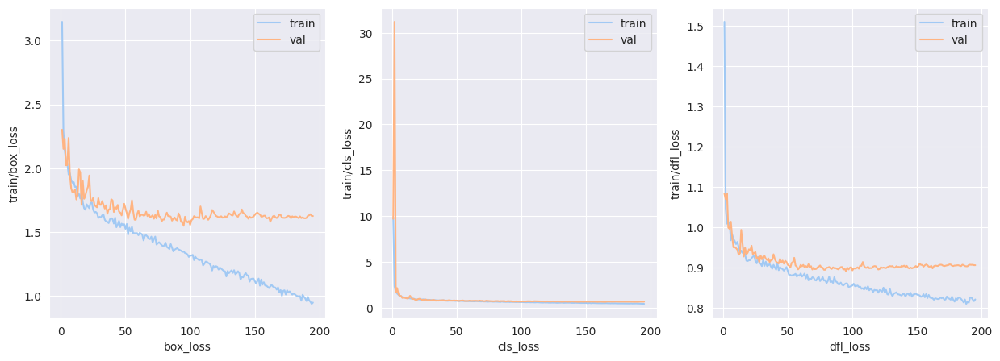

In [ ]:
#Plotting the losses
plt.figure(figsize=(15,5))
k=1
for i in ['box_loss','cls_loss','dfl_loss']:
    ax=plt.subplot(1,3,k)
    sns.lineplot(df_result,x='epoch',y='train/'+i,label='train',ax=ax)
    sns.lineplot(df_result,x='epoch',y='val/'+i,label='val',ax=ax)
    ax.set_xlabel(i)
    k+=1


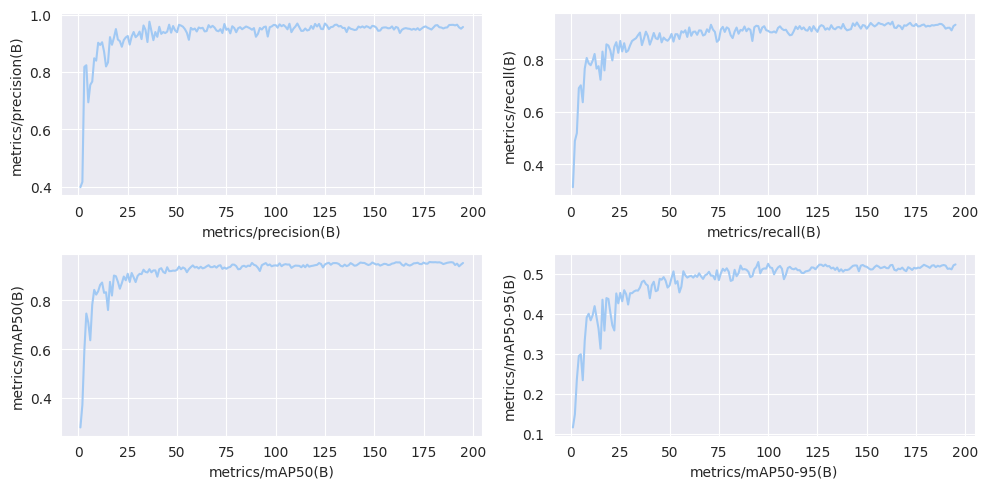

In [ ]:
#Plotting the metrics
plt.figure(figsize=(10,5))
k=1
for i in ['metrics/precision(B)','metrics/recall(B)','metrics/mAP50(B)','metrics/mAP50-95(B)']:
    ax=plt.subplot(2,2,k)
    sns.lineplot(df_result,x='epoch',y=i,ax=ax)
    ax.set_xlabel(i)
    k+=1
plt.tight_layout()

In [ ]:
#Creating function to visualize result:
def visualize_result(dir_name,list_images):
    k=1
    plt.figure(figsize=(20,15))
    for filename in list_images:
            ax=plt.subplot((len(list_images)//2+1),2,k)
            img_path=os.path.join(dir_name,filename)
            img=plt.imread(img_path)
            ax.imshow(img)
            ax.set_xlabel(filename)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])
            k+=1
    plt.tight_layout()
    plt.show()


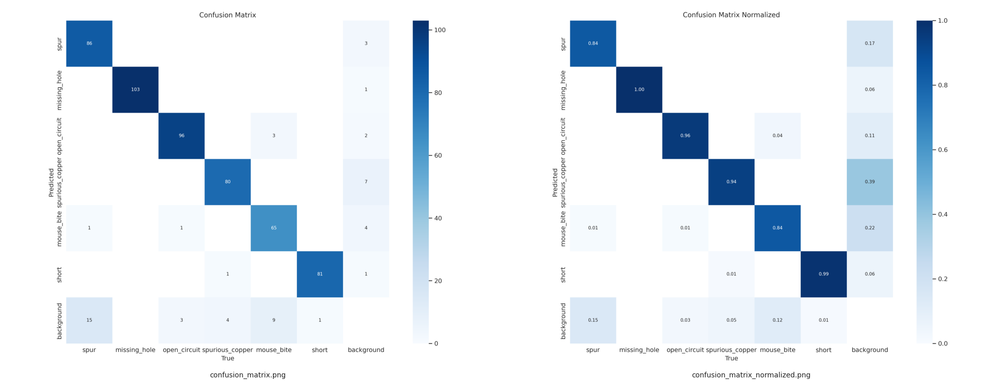

In [ ]:
#Visualizing confusion matrix
list_confusion=['confusion_matrix.png','confusion_matrix_normalized.png']
visualize_result(result_dir,list_confusion)

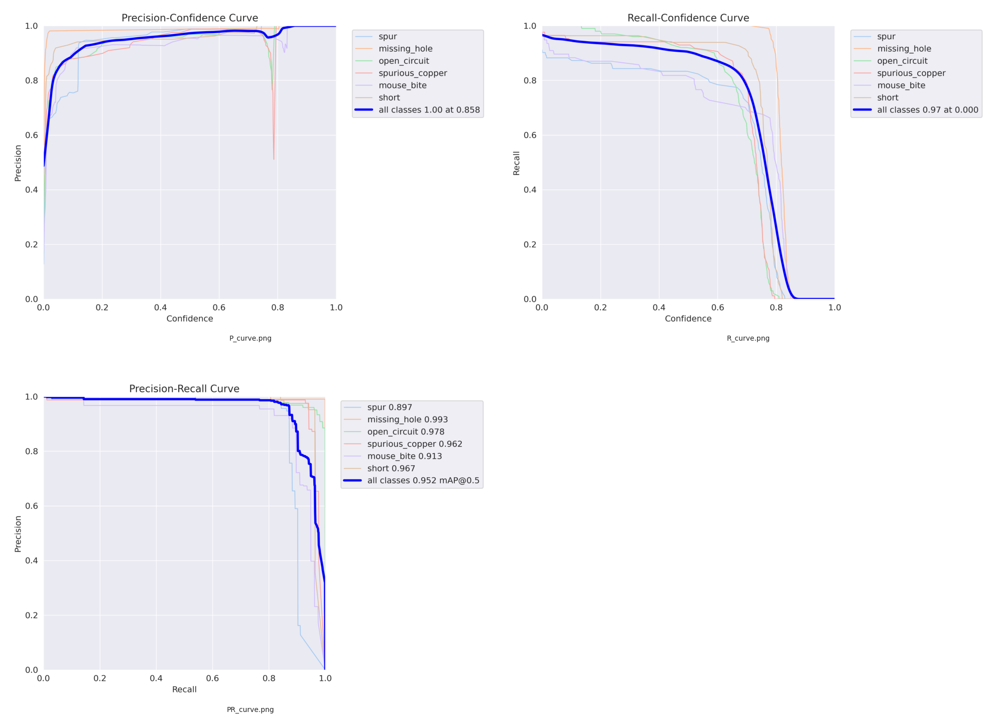

In [ ]:
#Visualizing metrics
list_curve=['P_curve.png','R_curve.png','PR_curve.png']
visualize_result(result_dir,list_curve)

**Mean Average Precision on validation set at 0.5 threshold=0.952**

# **Evaluating on val & Test Data**

In [ ]:
#Now let's load our best model to evaluate
os.listdir(os.path.join(result_dir,'weights'))
best_model_path=os.path.join(result_dir,'weights','last.pt')
best_model=YOLO(best_model_path)

In [ ]:
#Defing a function to view prediction against actual  along with bounding box

def draw_bounding_boxes_predict_actual(image_path,bounding_boxes_actual,bounding_boxes_predict,annotation_actual,annotation_predict):

    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(10,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box for actual
    for bbox in bounding_boxes_actual:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation_actual,(centroid_x,centroid_y),(max_x+20,max_y+20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')

     # Draw each bounding box for predicted
    for bbox in bounding_boxes_predict:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='yellow', facecolor='none')
        ax.add_patch(rect)

        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation_predict,(centroid_x,centroid_y),(min_x-20,min_y-20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')

    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    imagename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    plt.xlabel(imagename)

    # Show the plot
    plt.show()

In [ ]:
#Defining the function to predict and return annoted image
def model_predict_compare(model,image_path,df_annot):

    result_test=model.predict(image_path)
    for r in result_test:
        if r.boxes.xyxy.cpu().numpy().size!=0:
            bounding_boxes_predict=r.boxes.xyxy.cpu().numpy()  #Numpy array of bounding box
            class_dict=r.names                         #Class dict
            pred_class=r.boxes.cls.cpu().numpy()[0].astype('int') #Predicted classes

            annotation_predict=class_dict[pred_class]
        else:
            bounding_boxes_predict=[]
            annotation_predict=''


    filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    df_selected=df_annot[df_annot['filename']==filename]

    xmin=df_selected['xmin'].values
    ymin=df_selected['ymin'].values
    xmax=df_selected['xmax'].values
    ymax=df_selected['ymax'].values

    annotation_actual=str(df_selected['class'].values[0])

    bounding_boxes_actual=zip(xmin,ymin,xmax,ymax)

    draw_bounding_boxes_predict_actual(image_path,bounding_boxes_actual,bounding_boxes_predict,'actual_'+annotation_actual,'predicted_'+annotation_predict)




image 1/1 /content/dataset/images/val/04_spurious_copper_08.jpg: 544x640 3 spurious_coppers, 51.0ms
Speed: 3.6ms preprocess, 51.0ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)


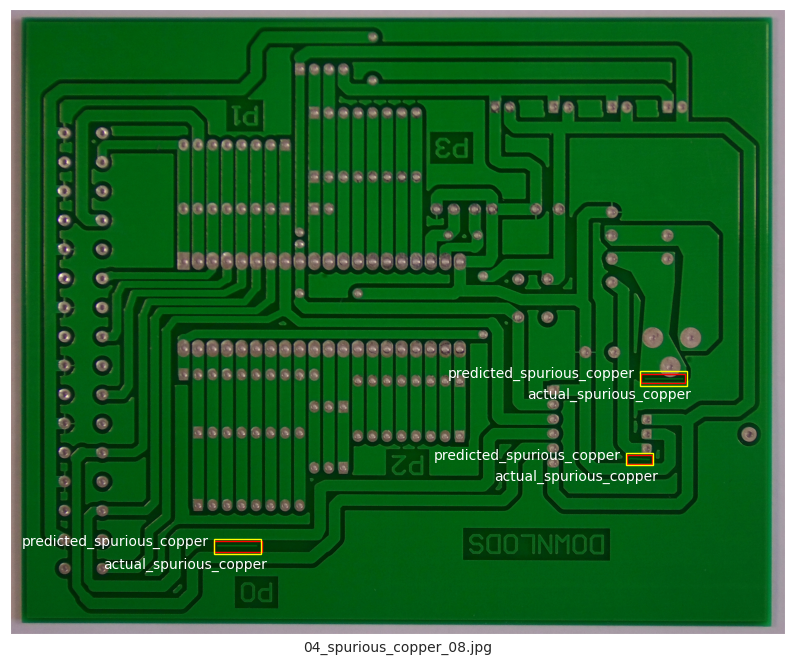


image 1/1 /content/dataset/images/val/04_short_04.jpg: 544x640 3 shorts, 35.5ms
Speed: 4.4ms preprocess, 35.5ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)


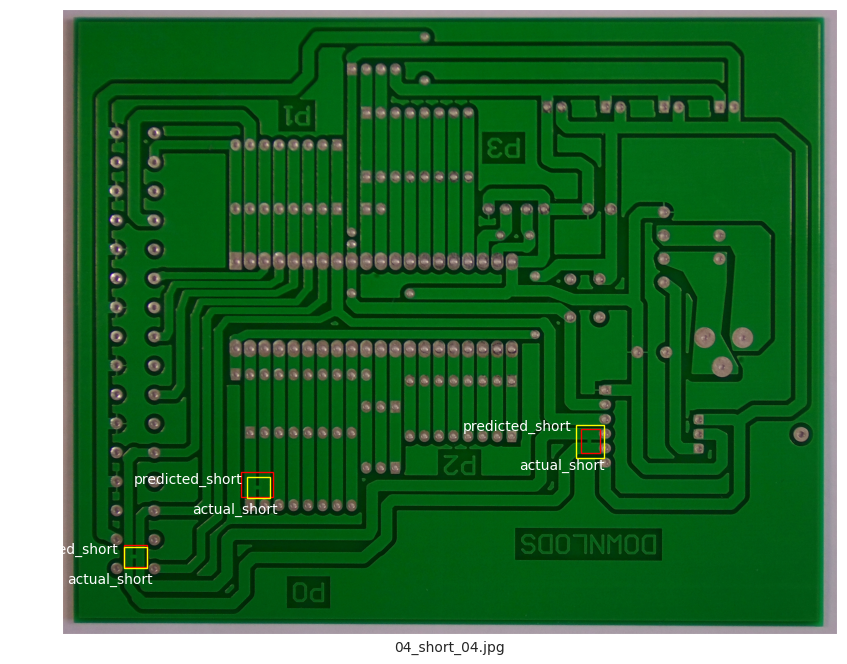


image 1/1 /content/dataset/images/val/04_spurious_copper_12.jpg: 544x640 3 spurious_coppers, 35.5ms
Speed: 4.5ms preprocess, 35.5ms inference, 2.0ms postprocess per image at shape (1, 3, 544, 640)


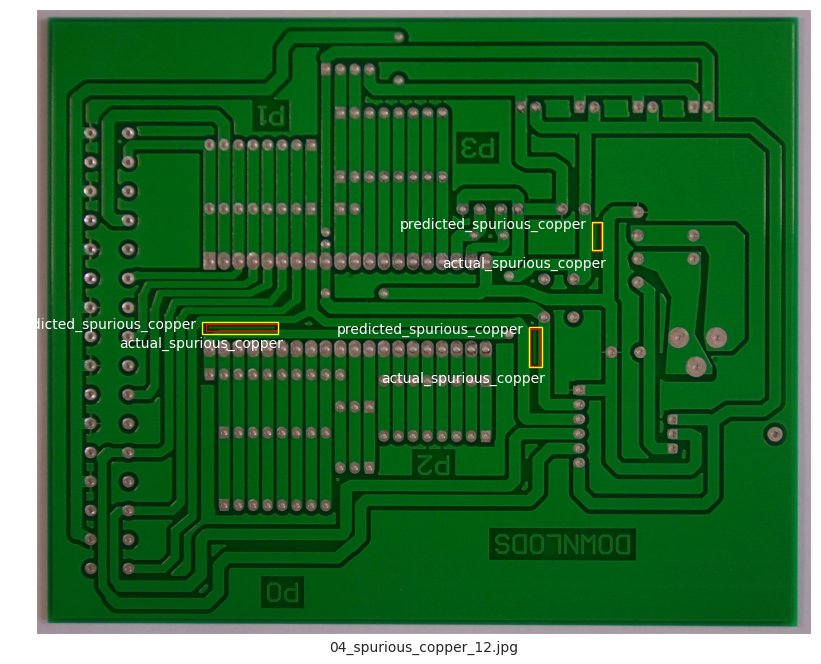


image 1/1 /content/dataset/images/val/08_open_circuit_09.jpg: 512x640 5 open_circuits, 244.6ms
Speed: 4.5ms preprocess, 244.6ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 640)


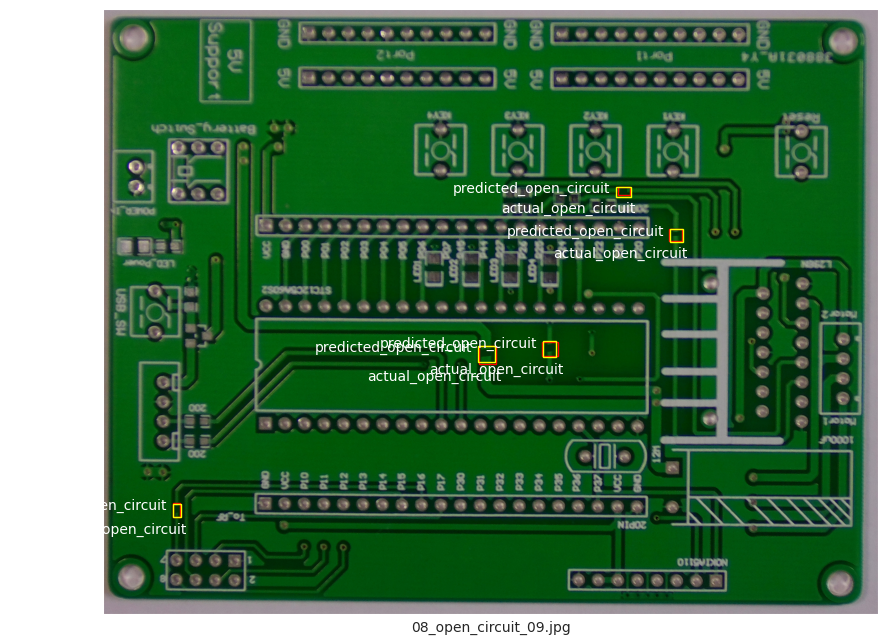


image 1/1 /content/dataset/images/val/11_spur_10.jpg: 640x640 5 spurs, 79.7ms
Speed: 13.5ms preprocess, 79.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


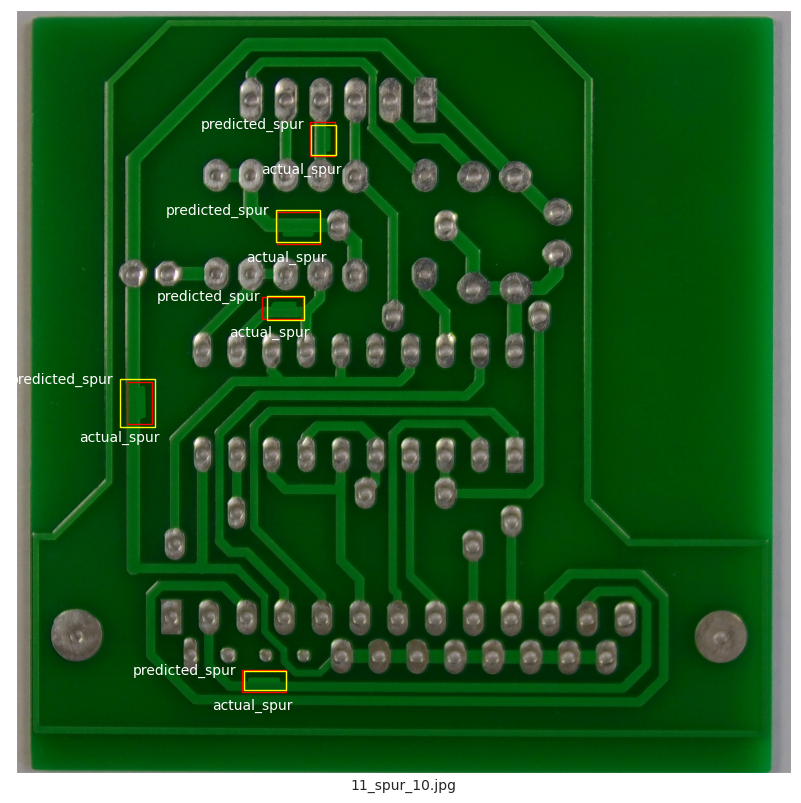

In [ ]:
#Predicting on val data for 5 val images
val_image_dir=os.path.join(images_dir,'val')
for i in os.listdir(val_image_dir)[0:5]:
    model_predict_compare(best_model,os.path.join(val_image_dir,i),df_annot)


image 1/1 /content/dataset/images/test/08_short_05.jpg: 512x640 6 shorts, 31.0ms
Speed: 4.5ms preprocess, 31.0ms inference, 2.1ms postprocess per image at shape (1, 3, 512, 640)


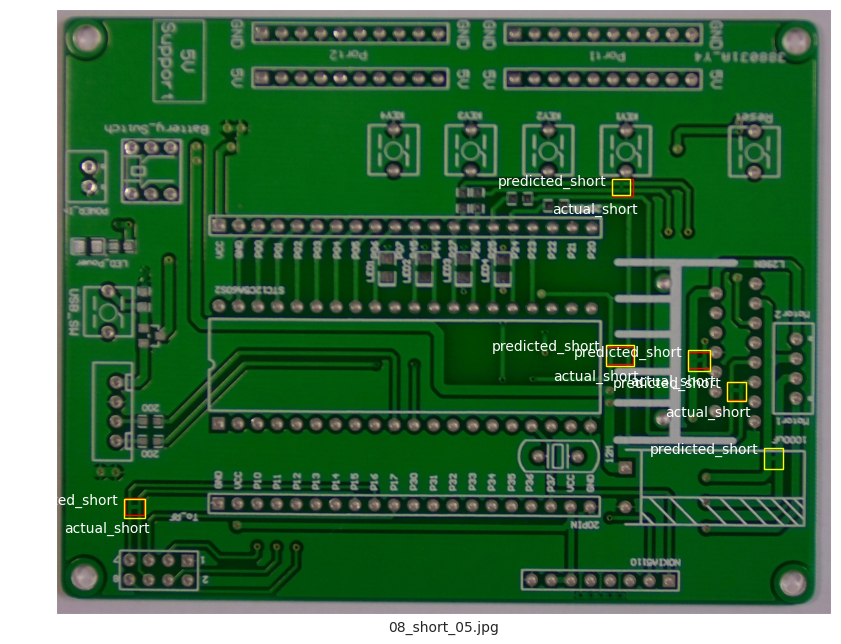


image 1/1 /content/dataset/images/test/01_spurious_copper_19.jpg: 352x640 1 spurious_copper, 90.9ms
Speed: 7.0ms preprocess, 90.9ms inference, 13.8ms postprocess per image at shape (1, 3, 352, 640)


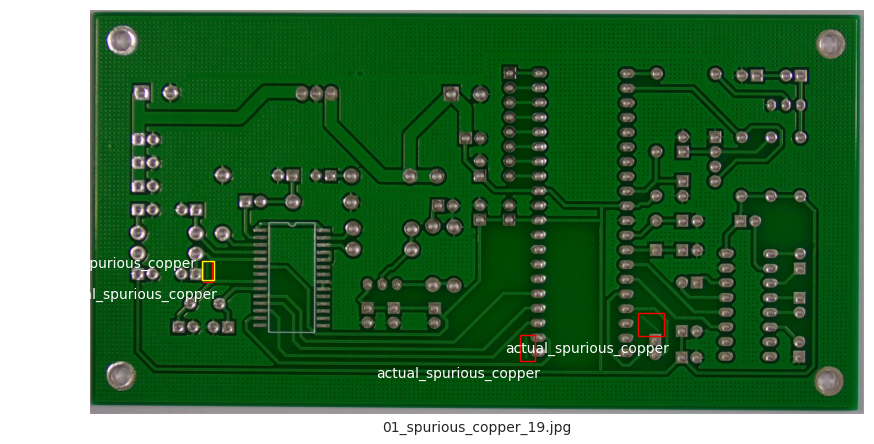


image 1/1 /content/dataset/images/test/12_short_07.jpg: 640x640 4 shorts, 38.5ms
Speed: 5.1ms preprocess, 38.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


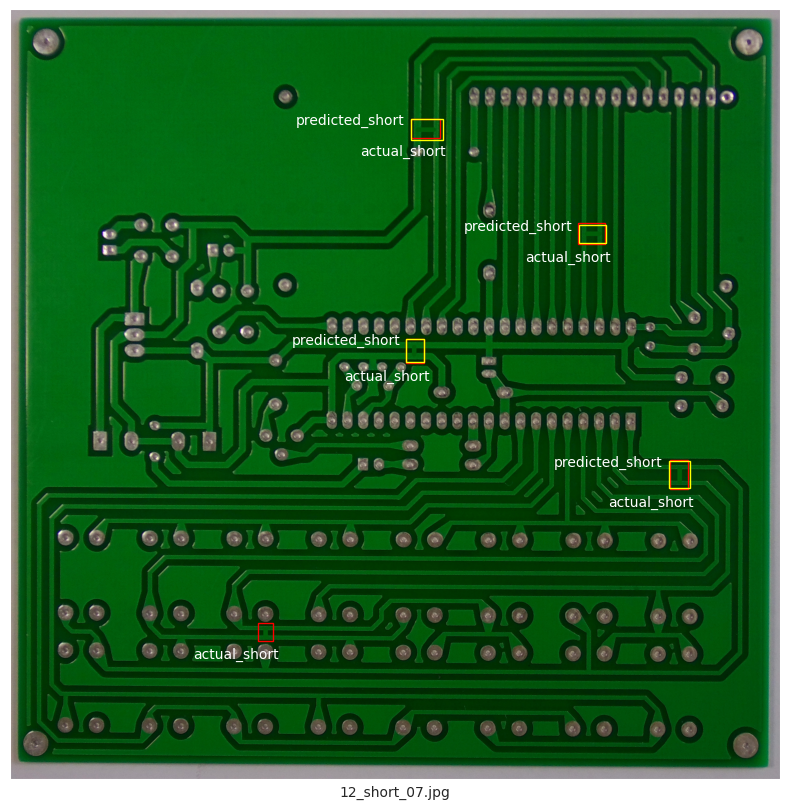


image 1/1 /content/dataset/images/test/04_short_02.jpg: 544x640 3 shorts, 36.8ms
Speed: 4.5ms preprocess, 36.8ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)


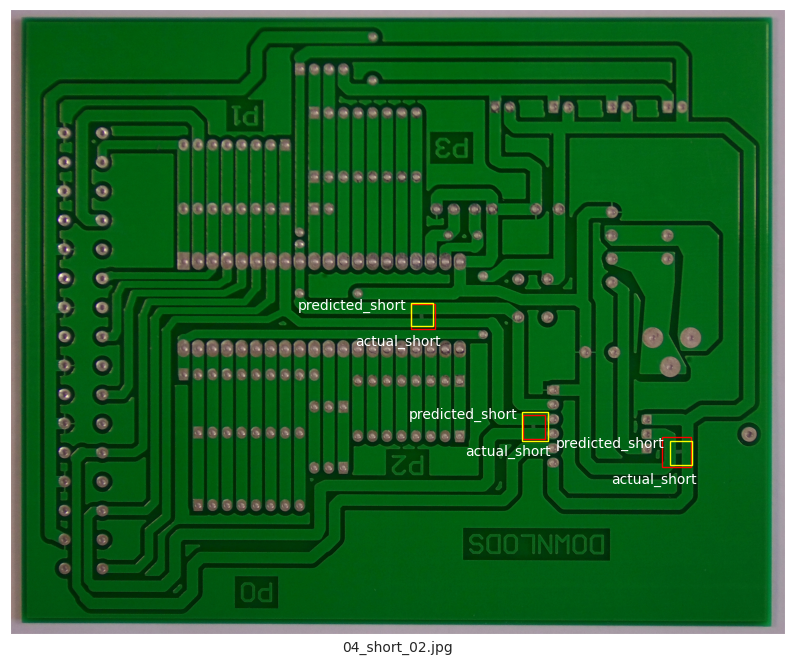


image 1/1 /content/dataset/images/test/06_spurious_copper_03.jpg: 544x640 5 spurious_coppers, 35.5ms
Speed: 4.3ms preprocess, 35.5ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)


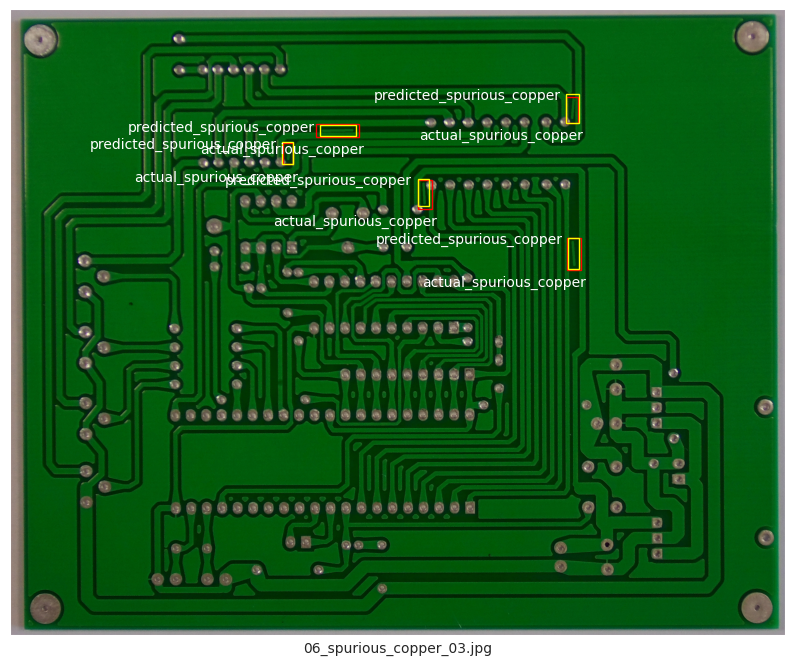

In [ ]:
#Predicting on test data for 5 test images
test_image_dir=os.path.join(images_dir,'test')
for i in os.listdir(test_image_dir)[0:5]:
    model_predict_compare(best_model,os.path.join(test_image_dir,i),df_annot)

Generating metrics for test dataset by using the test dataset as val dataset and predicting

In [ ]:
def move_to_dummy(original_dir,dummy_dir):
    if os.path.exists(dummy_dir):
        shutil.rmtree(dummy_dir) #Remove if exists
    os.makedirs(dummy_dir)

    images_dum_val_dir=os.path.join(dummy_dir,'images','val')
    labels_dum_val_dir=os.path.join(dummy_dir,'labels','val')
    images_dum_train_dir=os.path.join(dummy_dir,'images','train')
    labels_dum_train_dir=os.path.join(dummy_dir,'labels','train')

    os.makedirs(images_dum_val_dir)
    os.makedirs(labels_dum_val_dir)
    os.makedirs(images_dum_train_dir)
    os.makedirs(labels_dum_train_dir)

    images_test_dir=os.path.join(original_dir,'images','test')
    labels_test_dir=os.path.join(original_dir,'labels','test')
    images_train_dir=os.path.join(original_dir,'images','train')
    labels_train_dir=os.path.join(original_dir,'labels','train')

    for i in os.listdir(images_test_dir):
        shutil.copy(os.path.join(images_test_dir,i),os.path.join(images_dum_val_dir,i))
    for i in os.listdir(labels_test_dir):
        shutil.copy(os.path.join(labels_test_dir,i),os.path.join(labels_dum_val_dir,i))
    for i in os.listdir(images_train_dir):
        shutil.copy(os.path.join(images_train_dir,i),os.path.join(images_dum_train_dir,i))
    for i in os.listdir(labels_train_dir):
        shutil.copy(os.path.join(labels_train_dir,i),os.path.join(labels_dum_train_dir,i))

In [ ]:
original_dir=os.path.join(root_dir,'dataset')
dummy_dir=os.path.join(root_dir,'dummy_dataset')

move_to_dummy(original_dir,dummy_dir)

print(f"Length of image files:{len(os.listdir(os.path.join(dummy_dir,'images','val')))}")
print(f"Length of label files:{len(os.listdir(os.path.join(dummy_dir,'labels','val')))}")

Length of image files:35
Length of label files:35


Creating yaml file

In [ ]:
#Creating YAML format
data_test_yaml={
    'path':str(os.path.join(root_dir,'dummy_dataset')),
    'train':'images/train',
    'val':'images/val',
    'nc': len(class_dict),
    'names': list(class_dict.values())
}
data_test_yaml

{'path': '/content/dummy_dataset',
 'train': 'images/train',
 'val': 'images/val',
 'nc': 6,
 'names': ['spur',
  'missing_hole',
  'open_circuit',
  'spurious_copper',
  'mouse_bite',
  'short']}

In [ ]:
#Creating yaml file
import yaml

#Writing to yaml file
with open('data_test.yaml', 'w') as f:
    yaml.dump(data_test_yaml, f, default_flow_style=False)

In [ ]:
result_val=best_model.val(data=os.path.join(root_dir,'data_test.yaml'))

Ultralytics 8.3.50 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dummy_dataset/labels/val... 35 images, 0 backgrounds, 0 corrupt: 100%|██████████| 35/35 [00:00<00:00, 1387.91it/s]

val: New cache created: /content/dummy_dataset/labels/val.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:03<00:00,  1.11s/it]


                   all         35        150      0.953      0.925      0.932      0.522
                  spur          7         31          1      0.962       0.98      0.521
          missing_hole          6         23      0.968          1      0.995      0.601
          open_circuit          2          6          1      0.655      0.721       0.43
       spurious_copper          7         31      0.887      0.935      0.929      0.542
            mouse_bite          4         20      0.887          1      0.995      0.523
                 short          9         39      0.975          1      0.973      0.515
Speed: 0.2ms preprocess, 31.5ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs/detect/val


In [ ]:
result_val_dir='/content/runs/detect/val'

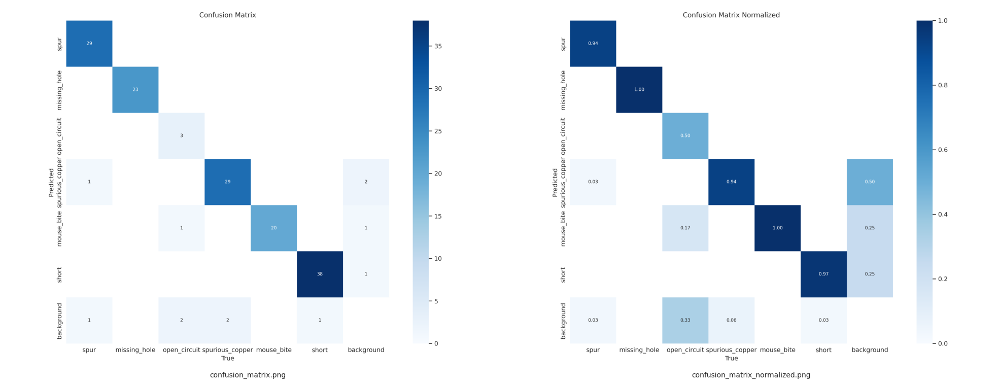

In [ ]:
#Visualizing confusion matrix
list_confusion=['confusion_matrix.png','confusion_matrix_normalized.png']
visualize_result(result_val_dir,list_confusion)

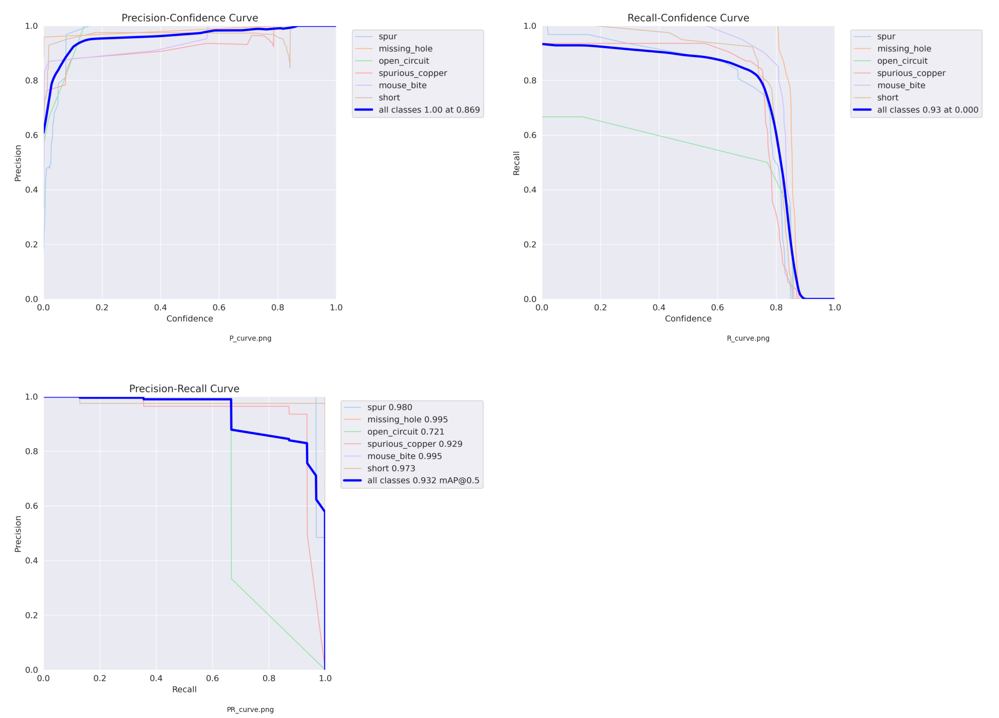

In [ ]:
#Visualizing metrics
list_curve=['P_curve.png','R_curve.png','PR_curve.png']
visualize_result(result_val_dir,list_curve)

**Mean Average Precision on test set at 0.5 threshold=0.932**

# **Creating a function to predict & return annoted image**

In [ ]:
#Defing a function to view image along with bounding box

def draw_bounding_boxes_image(image_path, bounding_boxes,annotation):
    """
    Draws multiple bounding boxes on an image using Matplotlib.

    Args:
        image_path: The path to the image file.
        bounding_boxes: A list of bounding boxes, each represented as a tuple or list containing
                       (min_x, min_y, max_x, max_y).
    """

    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(10,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box for actual
    if len(bounding_boxes)==0:
        plt.text(0.5, 0.5, 'No defects detected',
                 horizontalalignment='center',verticalalignment='center',color='white',fontsize=16)

    else:
        for bbox in bounding_boxes:
            min_x, min_y, max_x, max_y = bbox
            width = max_x - min_x
            height = max_y - min_y
            rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
            ax.add_patch(rect)

            # Calculate the centroid of the bounding box
            centroid_x = (min_x + max_x) / 2
            centroid_y = (min_y + max_y) / 2

            # Add the annotation to the centroid
            ax.annotate( annotation,(centroid_x,centroid_y),(max_x+20,max_y+20),
                fontsize=10,color='white',
                horizontalalignment='right', verticalalignment='top')


    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    imagename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    plt.xlabel(imagename)

    # Show the plot
    plt.show()

In [ ]:
#Defining the function to predict and return annoted image
def model_predict(model,image_path):

    result_test=model.predict(image_path)
    for r in result_test:
        if r.boxes.xyxy.cpu().numpy().size!=0:
            bounding_boxes=r.boxes.xyxy.cpu().numpy()  #Numpy array of bounding box
            class_dict=r.names                         #Class dict
            pred_class=r.boxes.cls.cpu().numpy()[0].astype('int') #Predicted classes
            annotation=class_dict[pred_class]
        else:
            bounding_boxes=[]
            annotation=''



    draw_bounding_boxes_image(image_path, bounding_boxes,annotation)





image 1/1 /content/dummy_dataset/images/val/08_short_05.jpg: 512x640 6 shorts, 31.0ms
Speed: 3.0ms preprocess, 31.0ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)


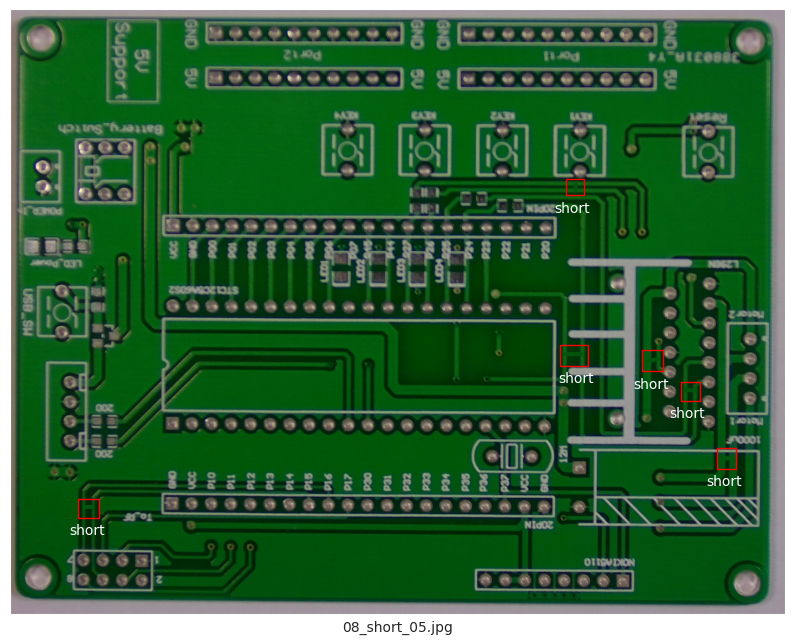


image 1/1 /content/dummy_dataset/images/val/12_short_07.jpg: 640x640 4 shorts, 38.3ms
Speed: 5.5ms preprocess, 38.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


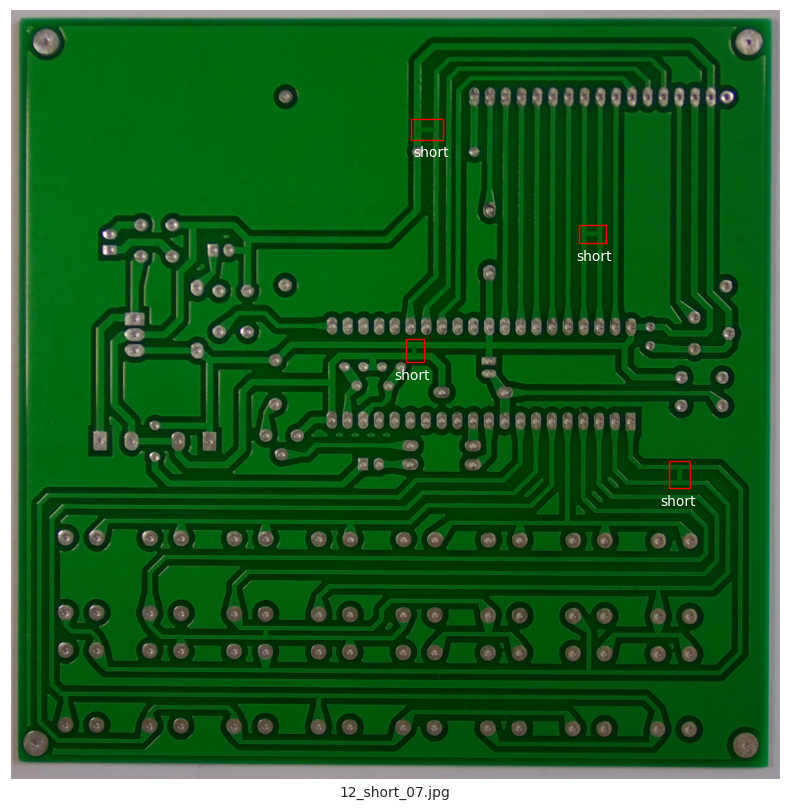


image 1/1 /content/dummy_dataset/images/val/06_spurious_copper_03.jpg: 544x640 5 spurious_coppers, 38.7ms
Speed: 4.7ms preprocess, 38.7ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)


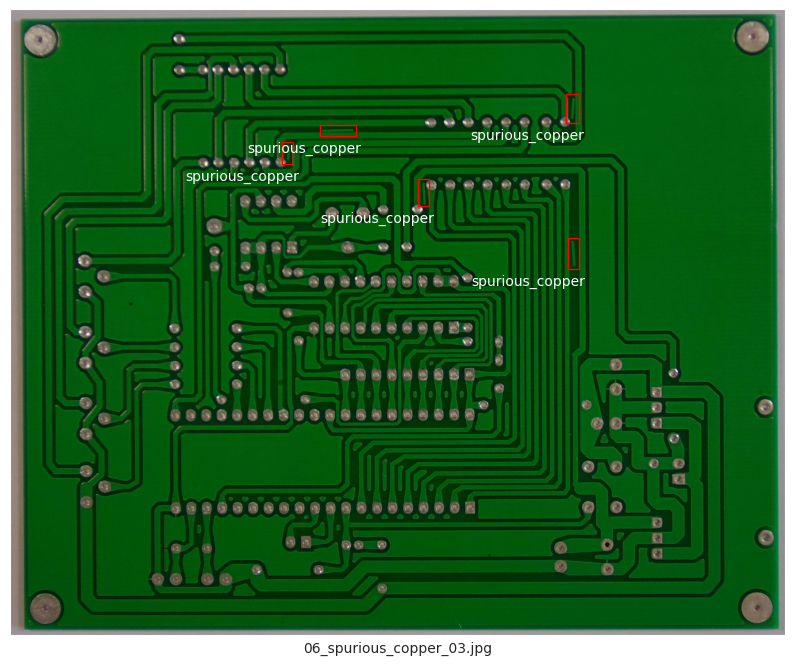


image 1/1 /content/dummy_dataset/images/val/06_spur_03.jpg: 544x640 5 spurs, 35.5ms
Speed: 4.5ms preprocess, 35.5ms inference, 2.0ms postprocess per image at shape (1, 3, 544, 640)


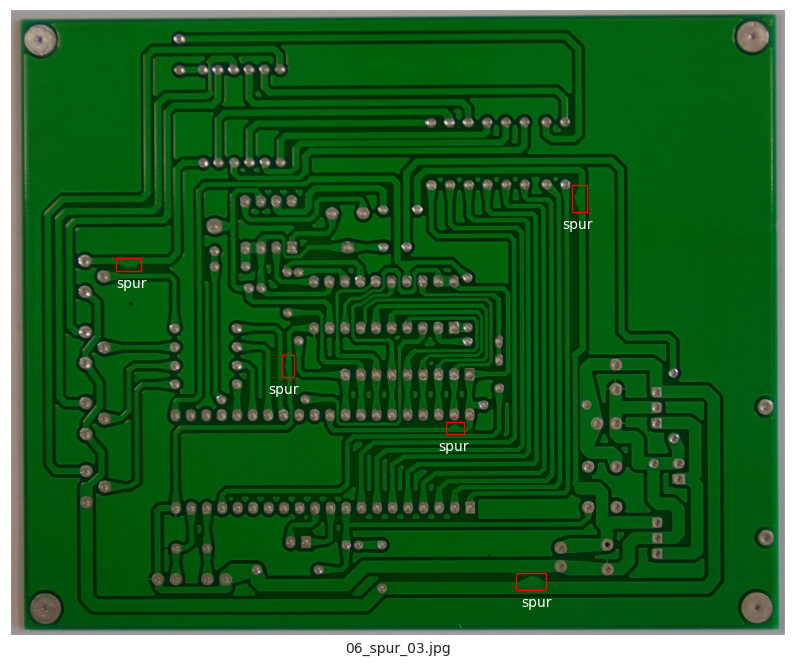


image 1/1 /content/dummy_dataset/images/val/09_missing_hole_10.jpg: 512x640 5 missing_holes, 31.0ms
Speed: 4.3ms preprocess, 31.0ms inference, 11.1ms postprocess per image at shape (1, 3, 512, 640)


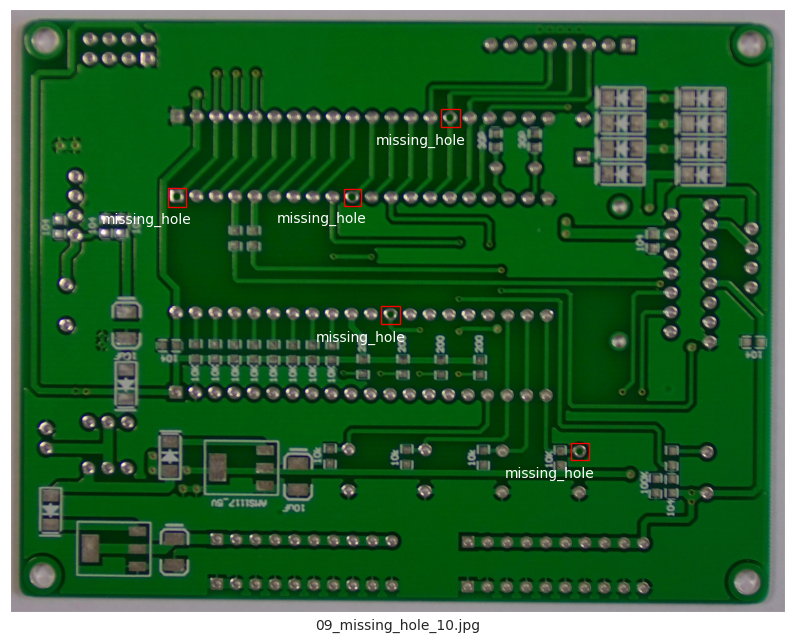

In [ ]:
#Testing on sample data
for i in os.listdir(os.path.join(dummy_dir,'images','val'))[0:10:2]:
    image_path=os.path.join(dummy_dir,'images','val',i)
    model_predict(model=best_model,image_path=image_path)